# **HW4 - Movie Recommendation System**

## **1. Recommendation System with LHS** 

### 1.1 Data Preparation

In [1]:
#!pip install datasketch
# import necessary libraries
import numpy as np
import pandas as pd
import re
import time
from datasketch import MinHash, MinHashLSHForest

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from scipy.sparse import csr_matrix
from sklearn.decomposition import TruncatedSVD


In [2]:
# Read all datasets
genome_scores = pd.read_csv("C:/Users/hp/Desktop/movielens-20m-dataset/genome_scores.csv")
genome_tags = pd.read_csv("C:/Users/hp/Desktop/movielens-20m-dataset/genome_tags.csv")
link = pd.read_csv("C:/Users/hp/Desktop/movielens-20m-dataset/link.csv")
movie = pd.read_csv("C:/Users/hp/Desktop/movielens-20m-dataset/movie.csv")
rating = pd.read_csv("C:/Users/hp/Desktop/movielens-20m-dataset/rating.csv")
tag = pd.read_csv("C:/Users/hp/Desktop/movielens-20m-dataset/tag.csv")


In [ ]:
movie = pd.read_csv('C:/Users/EMILIO/Documents/università/ADM/HMW 4/movie.csv')
ratings = pd.read_csv('C:/Users/EMILIO/Documents/università/ADM/HMW 4/rating.csv')
genome_scores = pd.read_csv('C:/Users/EMILIO/Documents/università/ADM/HMW 4/genome_scores.csv') 
tags = pd.read_csv('C:/Users/EMILIO/Documents/università/ADM/HMW 4/tag.csv')
genome_tags = pd.read_csv('C:/Users/EMILIO/Documents/università/ADM/HMW 4/genome_tags.csv')


In [3]:
# Replaces genre separators ('|') in the 'genres' column with spaces.
movie['genres'] = movie['genres'].str.replace('|', ' ')
tfidf = TfidfVectorizer(stop_words='english')


In [4]:
# Display informations about the datasets.
print("\nInfo about 'movies':")
print(movie.info())

print("\nInfo about 'ratings':")
print(rating.info())


print("\nInfo about 'tag':")
print(tag.info())

print("\nInfo about 'genome_tags':")
print(genome_tags.info())


print("\nInfo about 'genome_scores':")
print(genome_scores.info())

print("\nInfo about 'link':")
print(link.info())


Info about 'movies':
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27278 entries, 0 to 27277
Data columns (total 3 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   movieId  27278 non-null  int64 
 1   title    27278 non-null  object
 2   genres   27278 non-null  object
dtypes: int64(1), object(2)
memory usage: 639.5+ KB
None

Info about 'ratings':
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20000263 entries, 0 to 20000262
Data columns (total 4 columns):
 #   Column     Dtype  
---  ------     -----  
 0   userId     int64  
 1   movieId    int64  
 2   rating     float64
 3   timestamp  object 
dtypes: float64(1), int64(2), object(1)
memory usage: 610.4+ MB
None

Info about 'tag':
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 465564 entries, 0 to 465563
Data columns (total 4 columns):
 #   Column     Non-Null Count   Dtype 
---  ------     --------------   ----- 
 0   userId     465564 non-null  int64 
 1   movieId    465564 non-nu

In [5]:
# Display basic information and the first few rows of each dataset for an initial inspection.
display(movie.head())
display(movie.head())
display(rating.head())
display(tag.head())
display(genome_tags.head())
display(genome_scores.head())
display(link.head())

,movieId,title,genres
0,1,Toy Story (1995),Adventure Animation Children Comedy Fantasy
1,2,Jumanji (1995),Adventure Children Fantasy
2,3,Grumpier Old Men (1995),Comedy Romance
3,4,Waiting to Exhale (1995),Comedy Drama Romance
4,5,Father of the Bride Part II (1995),Comedy


,movieId,title,genres
0,1,Toy Story (1995),Adventure Animation Children Comedy Fantasy
1,2,Jumanji (1995),Adventure Children Fantasy
2,3,Grumpier Old Men (1995),Comedy Romance
3,4,Waiting to Exhale (1995),Comedy Drama Romance
4,5,Father of the Bride Part II (1995),Comedy


,userId,movieId,rating,timestamp
0,1,2,3.5,2005-04-02 23:53:47
1,1,29,3.5,2005-04-02 23:31:16
2,1,32,3.5,2005-04-02 23:33:39
3,1,47,3.5,2005-04-02 23:32:07
4,1,50,3.5,2005-04-02 23:29:40


,userId,movieId,tag,timestamp
0,18,4141,Mark Waters,2009-04-24 18:19:40
1,65,208,dark hero,2013-05-10 01:41:18
2,65,353,dark hero,2013-05-10 01:41:19
3,65,521,noir thriller,2013-05-10 01:39:43
4,65,592,dark hero,2013-05-10 01:41:18


,tagId,tag
0,1,007
1,2,007 (series)
2,3,18th century
3,4,1920s
4,5,1930s


,movieId,tagId,relevance
0,1,1,0.02500
1,1,2,0.02500
2,1,3,0.05775
3,1,4,0.09675
4,1,5,0.14675


,movieId,imdbId,tmdbId
0,1,114709,862.0
1,2,113497,8844.0
2,3,113228,15602.0
3,4,114885,31357.0
4,5,113041,11862.0


In [6]:
# Checks for missing values in each dataset and prints the results.
print(rating.isnull().sum())
print(movie.isnull().sum())
print(tag.isnull().sum())
print(link.isnull().sum())
print(genome_scores.isnull().sum())
print(genome_tags.isnull().sum())

userId       0
movieId      0
rating       0
timestamp    0
dtype: int64
movieId    0
title      0
genres     0
dtype: int64
userId        0
movieId       0
tag          16
timestamp     0
dtype: int64
movieId      0
imdbId       0
tmdbId     252
dtype: int64
movieId      0
tagId        0
relevance    0
dtype: int64
tagId    0
tag      0
dtype: int64


In [7]:
# Check for missing values (NaN) in the datasets and print the count for each column.
print(rating.isna().sum())
print(movie.isna().sum())
print(tag.isna().sum())
print(link.isna().sum())
print(genome_scores.isna().sum())
print(genome_tags.isna().sum())

userId       0
movieId      0
rating       0
timestamp    0
dtype: int64
movieId    0
title      0
genres     0
dtype: int64
userId        0
movieId       0
tag          16
timestamp     0
dtype: int64
movieId      0
imdbId       0
tmdbId     252
dtype: int64
movieId      0
tagId        0
relevance    0
dtype: int64
tagId    0
tag      0
dtype: int64


In [8]:
# Replace missing values in 'tag' column with the word 'unknown'.
tag['tag'] = tag['tag'].fillna('unknown')
print(tag['tag'].isna().sum())  #Should return 0 

0


In [8]:
# Remove and display duplicate rows in the datasets.
display(rating.drop_duplicates())
display(movie.drop_duplicates())
display(tag.drop_duplicates())
display(link.drop_duplicates())
display(genome_scores.drop_duplicates())
display(genome_tags.drop_duplicates())

,userId,movieId,rating,timestamp
0,1,2,3.5,2005-04-02 23:53:47
1,1,29,3.5,2005-04-02 23:31:16
2,1,32,3.5,2005-04-02 23:33:39
3,1,47,3.5,2005-04-02 23:32:07
4,1,50,3.5,2005-04-02 23:29:40
...,...,...,...,...
20000258,138493,68954,4.5,2009-11-13 15:42:00
20000259,138493,69526,4.5,2009-12-03 18:31:48
20000260,138493,69644,3.0,2009-12-07 18:10:57
20000261,138493,70286,5.0,2009-11-13 15:42:24


,movieId,title,genres
0,1,Toy Story (1995),Adventure Animation Children Comedy Fantasy
1,2,Jumanji (1995),Adventure Children Fantasy
2,3,Grumpier Old Men (1995),Comedy Romance
3,4,Waiting to Exhale (1995),Comedy Drama Romance
4,5,Father of the Bride Part II (1995),Comedy
...,...,...,...
27273,131254,Kein Bund für's Leben (2007),Comedy
27274,131256,"Feuer, Eis & Dosenbier (2002)",Comedy
27275,131258,The Pirates (2014),Adventure
27276,131260,Rentun Ruusu (2001),(no genres listed)


,userId,movieId,tag,timestamp
0,18,4141,Mark Waters,2009-04-24 18:19:40
1,65,208,dark hero,2013-05-10 01:41:18
2,65,353,dark hero,2013-05-10 01:41:19
3,65,521,noir thriller,2013-05-10 01:39:43
4,65,592,dark hero,2013-05-10 01:41:18
...,...,...,...,...
465559,138446,55999,dragged,2013-01-23 23:29:32
465560,138446,55999,Jason Bateman,2013-01-23 23:29:38
465561,138446,55999,quirky,2013-01-23 23:29:38
465562,138446,55999,sad,2013-01-23 23:29:32


,movieId,imdbId,tmdbId
0,1,114709,862.0
1,2,113497,8844.0
2,3,113228,15602.0
3,4,114885,31357.0
4,5,113041,11862.0
...,...,...,...
27273,131254,466713,4436.0
27274,131256,277703,9274.0
27275,131258,3485166,285213.0
27276,131260,249110,32099.0


,movieId,tagId,relevance
0,1,1,0.02500
1,1,2,0.02500
2,1,3,0.05775
3,1,4,0.09675
4,1,5,0.14675
...,...,...,...
11709763,131170,1124,0.58775
11709764,131170,1125,0.01075
11709765,131170,1126,0.01575
11709766,131170,1127,0.11450


,tagId,tag
0,1,007
1,2,007 (series)
2,3,18th century
3,4,1920s
4,5,1930s
...,...,...
1123,1124,writing
1124,1125,wuxia
1125,1126,wwii
1126,1127,zombie


In [9]:
#Descriptive statistics for all datasets
print("\nDescriptive statistics for 'genome_scores':")
print(genome_scores.describe())

print("\nDescriptive statistics for 'genome_tags':")
print(genome_tags.describe(include='all'))  

print("\nDescriptive statistics for 'link':")
print(link.describe(include='all'))  

print("\nDescriptive statistics for 'movie':")
print(movie.describe(include='all'))  
print("\nDescriptive statistics for 'ratings':")
print(rating.describe())

print("\nDescriptive statistics for 'tag':")
print(tag.describe(include='all'))  


Descriptive statistics for 'genome_scores':
            movieId         tagId     relevance
count  1.170977e+07  1.170977e+07  1.170977e+07
mean   2.584297e+04  5.645000e+02  1.164833e-01
std    3.467615e+04  3.256254e+02  1.542463e-01
min    1.000000e+00  1.000000e+00  2.500000e-04
25%    2.926000e+03  2.827500e+02  2.425000e-02
50%    6.017000e+03  5.645000e+02  5.650000e-02
75%    4.606200e+04  8.462500e+02  1.415000e-01
max    1.311700e+05  1.128000e+03  1.000000e+00

Descriptive statistics for 'genome_tags':
              tagId      tag
count   1128.000000     1128
unique          NaN     1128
top             NaN  zombies
freq            NaN        1
mean     564.500000      NaN
std      325.769857      NaN
min        1.000000      NaN
25%      282.750000      NaN
50%      564.500000      NaN
75%      846.250000      NaN
max     1128.000000      NaN

Descriptive statistics for 'link':
             movieId        imdbId         tmdbId
count   27278.000000  2.727800e+04   27026.000

In [10]:
# Identifies movie IDs present in the 'rating' dataset but missing in the 'movie' dataset.
missing_movies = set(rating['movieId']) - set(movie['movieId'])
print(f"\n ID number of missing movie in 'movies' dataset: {len(missing_movies)}")



 ID number of missing movie in 'movies' dataset: 0


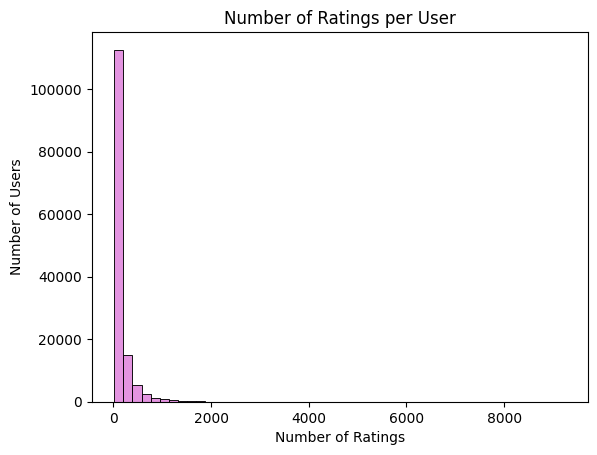

In [11]:
# Visualize the distribution of the number of ratings provided by users. 
# It shows how many users have contributed a specific number of ratings in the dataset.
import seaborn as sns
import matplotlib.pyplot as plt
user_ratings_count = rating['userId'].value_counts()  
sns.histplot(user_ratings_count, bins=50, kde=False, color= 'orchid')
plt.title('Number of Ratings per User')
plt.xlabel('Number of Ratings')
plt.ylabel('Number of Users')
plt.show()

Most users have contributed with very few ratings, with a large spike at the lower end of the scale. This indicates a significant proportion of users are casual raters.

A small number of users have provided a disproportionately high number of ratings. These are likely highly active or dedicated users.

This distribution highlights the uneven engagement level among users.

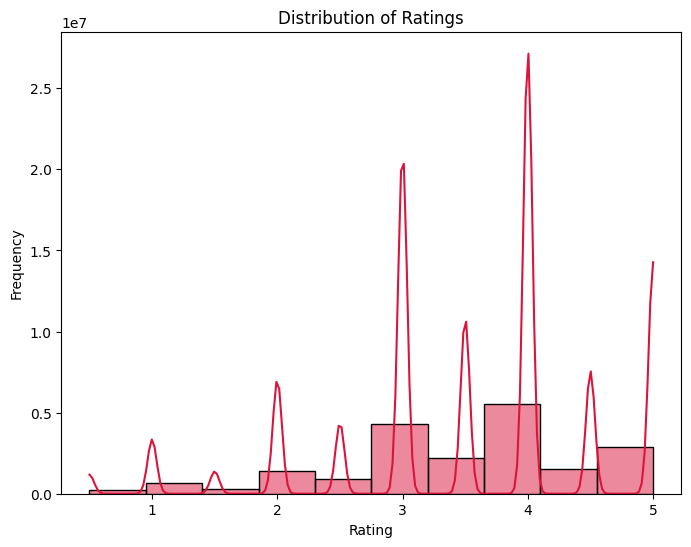

In [12]:
#The graph displays the distribution of ratings in the dataset. 
import seaborn as sns

# Rating distribution
plt.figure(figsize=(8, 6))
sns.histplot(rating['rating'], bins=10, kde=True, color='crimson')
plt.title('Distribution of Ratings')
plt.xlabel('Rating')
plt.ylabel('Frequency')
plt.show()


The most frequent ratings are clustered around the higher end of the scale, especially near 4.0 and 5.0. This suggests that users tend to give favorable ratings to movies.

Ratings at the lower end (1.0 or 2.0) are less common, indicating that users are less likely to leave very negative reviews.


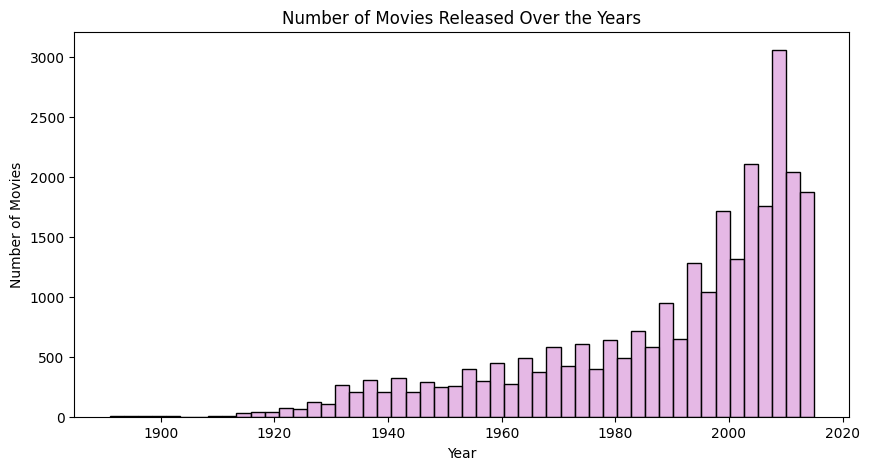

In [13]:
# Extract release year from the title 
movie['year'] = movie['title'].str.extract(r'\((\d{4})\)').astype(float)

plt.figure(figsize=(10, 5))
sns.histplot(movie['year'].dropna(), bins=50, kde=False, color= 'plum')
plt.title('Number of Movies Released Over the Years')
plt.xlabel('Year')
plt.ylabel('Number of Movies')
plt.show()

The number of movies released increases significantly over time, particularly after the 1980s. This reflects advancements in the film industry, technology, and global accessibility to cinema.

The graph peaks in the early 2000s, indicating a boom in movie production during that period. This could be attributed to the development of digital technology.

Very few movies were produced before the 1920s.

C:\Users\hp\AppData\Local\Temp\ipykernel_33628\3903319868.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=tag_counts.values, y=tag_counts.index, palette='viridis')


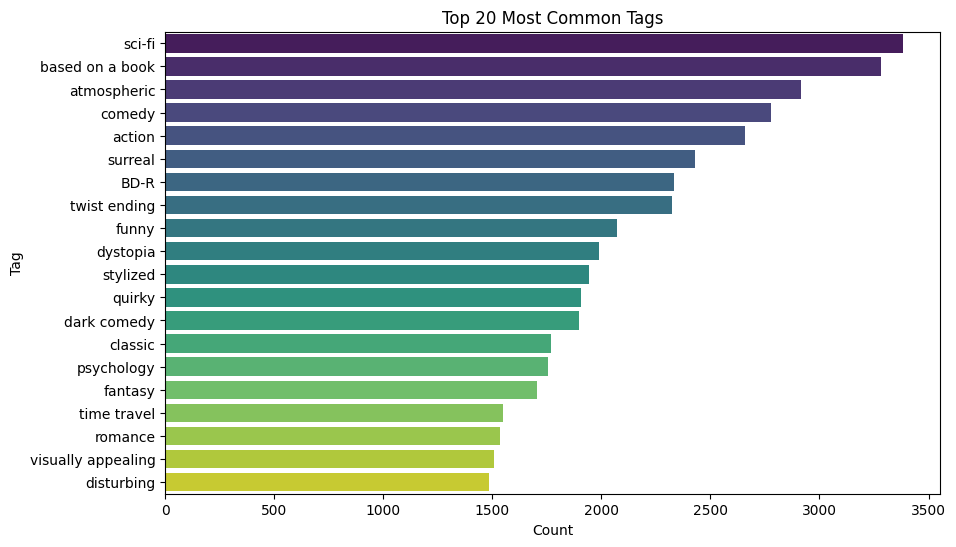

In [14]:
# Top 20 most commonly used tags.
tag_counts = tag['tag'].value_counts().head(20)
plt.figure(figsize=(10, 6))
sns.barplot(x=tag_counts.values, y=tag_counts.index, palette='viridis')
plt.title('Top 20 Most Common Tags')
plt.xlabel('Count')
plt.ylabel('Tag')
plt.show()


Tags like "sci-fi," "based on a book," and "atmospheric" are the most commonly assigned, suggesting these themes are the most popular.

Many tags describe genres (e.g., "comedy," "action," "fantasy") or stylistic elements (e.g., "atmospheric," "surreal"), indicating the importance of these features in user tagging behavior.


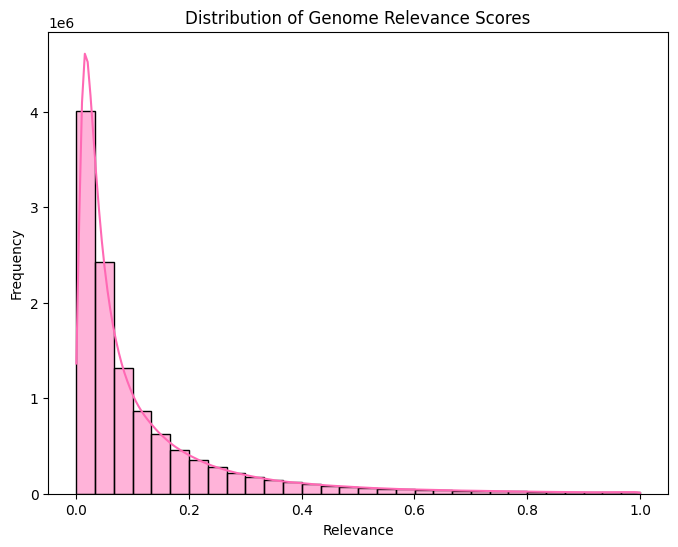

In [15]:
# Genome scores distribution
plt.figure(figsize=(8, 6))
sns.histplot(genome_scores['relevance'], bins=30, kde=True, color='hotpink')
plt.title('Distribution of Genome Relevance Scores')
plt.xlabel('Relevance')
plt.ylabel('Frequency')
plt.show()


The relevance scores are heavily skewed toward lower values, with the majority clustered around 0.0–0.2. This indicates that most tags have low relevance for the movies in the dataset.

There is a gradual decline as the relevance scores increase, showing that only a small number of tags are highly relevant (closer to 1.0).

The skewed distribution implies that most tags may not strongly influence recommendations, while a few highly relevant tags could play a crucial role in tagging movies effectively and refining recommendations.

### 1.2 Minhash Signatures 

For this point we grouped the dataset by `userId` and create a mapping where each user ID corresponds to the set of movies they have rated. This allows us to analyze user-specific preferences; then we calculated the Jaccard similarity to measure the similarity between two users' movie preferences. It calculates the number of common movies rated by both users to the total unique movies rated by either user.

Then, we used the method MinHash to estimate the Jaccard similarity. Instead of directly comparing sets, we compare compressed signature vectors generated through MinHashing. 



In [16]:
# Create a dictionary mapping each user ID to the set of movie IDs they have rated.
user_movies= rating.groupby('userId')['movieId'].apply(set).to_dict()

In [17]:
# Calculates the Jaccard similarity between two sets of movies.
def jaccard_similarity_exact(movies1, movies2):
    intersection = len(movies1 & movies2)  
    union = len(movies1 | movies2)         
    return intersection / union if union > 0 else 0

In [18]:
# Calculates the approximate Jaccard similarity between two MinHash signatures.

def jaccard_similarity_hashed(signature1, signature2):
    matches = sum(1 for x, y in zip(signature1, signature2) if x == y)
    return matches / len(signature1)


### 1.2.1

In the next step, we define a linear hash functions that transform an input `x` using the formula `(a * x + b) % c`. 

The `generate_hash_function` creates a single hash function using a linear formula.

The `generate_hash_functions` generates a set of hash functions for MinHash using linear formulas.

In [19]:
import numpy as np

def generate_hash_function(a, b, c):

    def hash_function(x):
        return (a * x + b) % c  

def generate_hash_functions(num_hashes, max_movie_id, seed=None):

    if seed is not None:
        np.random.seed(seed)  # Set seed for reproducibility.
    a = np.random.randint(1, max_movie_id, size=num_hashes)  # Random coefficients for a.
    b = np.random.randint(0, max_movie_id, size=num_hashes)  # Random coefficients for b.
    c = max_movie_id + 1 # Use max_movie_id + 1 as modulus (ensures unique outputs).
    return [generate_hash_function(a_, b_, c) for a_, b_ in zip(a, b)]  # Generate and return the hash functions.


In the followed steps, we will test three different MinHash functions: `2x`, `x^2`, `x // 2`, to determine which performs best in terms of accuracy and efficiency in finding similar users. We aim to identify the most accurate MinHash function for our recommendation system.

We introduce first a `2x` multiplier to the linear hash formula, which increases variability in the hash values. 



In [20]:
# Creates a hash function using a 2x multiplier in the formula.
def generate_hash_function_2x(a, b, c):

    def hash_function(x):
        return (a * 2 * x + b) % c  # Linear formula with 2x multiplier.
    return hash_function

# Generates a set of hash functions using the 2x multiplier
def generate_hash_functions_2x(num_hashes, max_movie_id, seed=None):

    if seed is not None:
        np.random.seed(seed)  
    a = np.random.randint(1, max_movie_id * 2, size=num_hashes)  
    b = np.random.randint(0, max_movie_id * 2, size=num_hashes)  
    c = max_movie_id * 2 + 1  
    return [generate_hash_function_2x(a_, b_, c) for a_, b_ in zip(a, b)]  



In the next code we use quadratic (x^2) method into the hash formula.

In [21]:
# Creates a hash function using a quadratic term in the formula.
def generate_hash_function_xe2(a, b, c):

    def hash_function(x):
        return (a * x / 2 + b * x) % c  # Combine linear and quadratic terms.
    return hash_function

# Generates a set of hash functions using quadratic terms.
def generate_hash_functions_xe2(num_hashes, max_movie_id, seed=None):

    if seed is not None:
        np.random.seed(seed) 
    a = np.random.randint(1, max_movie_id * 2, size=num_hashes)  
    b = np.random.randint(0, max_movie_id * 2, size=num_hashes)  
    c = max_movie_id * 2 + 1  # Use a modulus larger than max_movie_id.
    return [generate_hash_function_xe2(a_, b_, c) for a_, b_ in zip(a, b)]  


The next approach introduces division into the hash formula. By dividing values during hashing, we can test the impact of reduced output range on performance.

In [22]:
# Creates a hash function that incorporates division in the formula.
def generate_hash_function_div2(a, b, c):

    def hash_function(x):
        return (a * (x  // 2) + b) % c  # Introduce division into thehash formula
    return hash_function

# Generates a set of hash functions using division by 2 in the formula.
def generate_hash_functions_div2(num_hashes, max_movie_id, seed=None):
 
    if seed is not None:
        np.random.seed(seed)  
    a = np.random.randint(1, max_movie_id * 2, size=num_hashes)  
    b = np.random.randint(0, max_movie_id * 2, size=num_hashes)  
    c = max_movie_id * 2 + 1  # Use a modulus larger than max_movie_id.
    return [generate_hash_function_div2(a_, b_, c) for a_, b_ in zip(a, b)]  


### 1.2.2

The `compute_signature` function generates MinHash signatures for a given set of users using specified hash functions. These signatures are compact representations of each user's movie preferences, that are created to test efficiently comparisons between users.

In [23]:
# Generates the MinHash signatures for a subset of users.
def compute_signature(sample_users, user_movies, hash_functions):
    #Empty dictionary to store the signature matrix.
    signature_matrix = {}
    
    for user in sample_users:
        # Retrieve the set of movies rated by the user.
        movies = user_movies.get(user, set())
        
        if not movies:
            # If no movies are rated, assign an empty signature.
            signature_matrix[user] = [float('inf')] * len(hash_functions)
            continue  
        
        signature = []
        
        # Iterate through each hash function.
        for h in hash_functions:
            # Compute the minimum hash value for all movies rated by the user.
            min_hash = min(h(movie) for movie in movies)
            # Append the minimum hash value to the user's signature.
            signature.append(min_hash)
        
        # Store the computed signature in the signature matrix.
        signature_matrix[user] = signature
    
    
    return signature_matrix



The `calculate_mse` function computes the Mean Squared Error (MSE) and it quantifies the accuracy of the MinHash-based similarity estimation.



In [24]:
def calculate_mse(user_movies, signature_matrix, sample_users):

    # Initialize MSE accumulator and pair count.
    mse = 0
    n_pairs = 0
    
    for i, user1 in enumerate(sample_users):
        for user2 in sample_users[i+1:]:
            # Calculate the exact Jaccard similarity.
            exact_jaccard = jaccard_similarity_exact(user_movies[user1], user_movies[user2])
            
            # Calculate the estimated Jaccard similarity using MinHash signatures.
            hashed_jaccard = jaccard_similarity_hashed(signature_matrix[user1], signature_matrix[user2])
            
            # Compute the squared error.
            mse += (exact_jaccard - hashed_jaccard) ** 2
            # Increment the count of user pairs.
            n_pairs += 1
    
    return mse / n_pairs if n_pairs > 0 else 0



We select a sample of 100 users and generate MinHash signatures for each user using the three different hash function we created before (2x multiplier, quadratic terms, and division by 2). 


In [25]:
# Select the first 100 users for testing.
sample_users = list(user_movies.keys())[:100]
user_movies_sample = {user: user_movies[user] for user in sample_users}

# Generate hash functions using our three methods.
hash_functions_2x = generate_hash_functions_2x(num_hashes=10, max_movie_id=rating['movieId'].max(), seed=42)
hash_functions_xe2 = generate_hash_functions_xe2(num_hashes=10, max_movie_id=rating['movieId'].max(), seed=42)
hash_functions_div2 = generate_hash_functions_div2(num_hashes=10, max_movie_id=rating['movieId'].max(), seed=42)

# Compute MinHash signatures for the sample users.
signature_matrix_2x = compute_signature(sample_users, user_movies_sample, hash_functions_2x)
signature_matrix_xe2 = compute_signature(sample_users, user_movies_sample, hash_functions_xe2)
signature_matrix_div2 = compute_signature(sample_users, user_movies_sample, hash_functions_div2)

# Calculate the Mean Squared Error (MSE) for each type of hash function.
mse_2x = calculate_mse(user_movies, signature_matrix_2x, sample_users)
mse_xe2 = calculate_mse(user_movies, signature_matrix_xe2, sample_users)
mse_div2 = calculate_mse(user_movies, signature_matrix_div2, sample_users)


C:\Users\hp\AppData\Local\Temp\ipykernel_33628\654639984.py:5: RuntimeWarning: overflow encountered in scalar multiply
  return (a * 2 * x + b) % c  # Linear formula with 2x multiplier.


In [26]:
# Calculate the Mean Squared Error (MSE) for each hash function type.
print(f"MSE 2x: {mse_2x:.4f}")

print(f"MSE x^2: {mse_xe2:.4f}")

print(f"MSE x//2: {mse_div2:.4f}")


MSE 2x: 0.0044
MSE x^2: 0.0033
MSE x//2: 0.0043


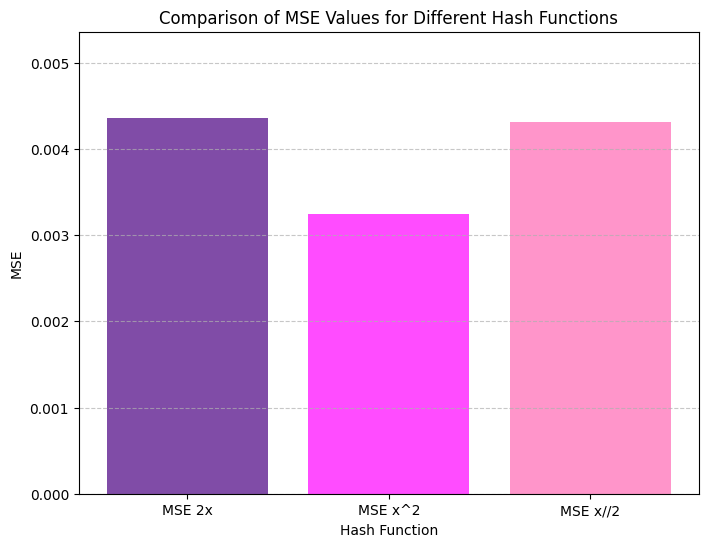

In [27]:
import matplotlib.pyplot as plt
# Create a bar plot to compare the Mean Squared Error (MSE) values for different hash functions.
mse_values = [mse_2x, mse_xe2, mse_div2]
labels = ['MSE 2x', 'MSE x^2', 'MSE x//2']

plt.figure(figsize=(8, 6))
plt.bar(labels, mse_values, color=['indigo', 'fuchsia', 'hotpink'], alpha=0.7)
plt.title('Comparison of MSE Values for Different Hash Functions')
plt.ylabel('MSE')
plt.xlabel('Hash Function')
plt.ylim(0, max(mse_values) + 0.001)
plt.grid(axis='y', linestyle='--', alpha=0.7)

plt.show()


The bar plot provides a visual representation of the Mean Squared Error (MSE) for each hash function (`2x, x^2, x//2`).


1. **MSE `2x`:** the MSE value is relatively high, indicating that the MinHash similarity estimation is less accurate with this configuration.
2. **MSE `x^2`:** this has the lowest MSE, suggesting that this configuration provides the most accurate similarity estimates among the three tested.
3. **MSE `x//2`:** the MSE is slightly higher than the quadratic configuration but still better than the `2x` multiplier.

Among the tested hash functions, the quadratic (`x^2`) hash function is the best choice for minimizing errors in the similarity estimates.




The next code generates two datasets:
- `real_similarities`: Represents similarity between users.

- `estimated_similarities`: Represents the approximations derived from the MinHash algorithm.

In [28]:
# Calculate real and estimated similarities between user pairs.
real_similarities = []  
estimated_similarities = []  

# Iterate through all unique pairs of users in the sample.
for i, user1 in enumerate(sample_users):
    for user2 in sample_users[i+1:]:
        # Calculate the exact Jaccard similarity for the pair of users based on their movie sets.
        real_sim = jaccard_similarity_exact(user_movies[user1], user_movies[user2])
        real_similarities.append(real_sim)  

        # Calculate the estimated similarity using MinHash signatures.
        estimated_sim = jaccard_similarity_hashed(signature_matrix_xe2[user1], signature_matrix_xe2[user2])
        estimated_similarities.append(estimated_sim)  


### 1.2.3

We tested the three hash function we created, across various similarity thresholds to determine the best-performing combinations.
Thresholds were defined in the range [0, 1] with a step size of 0.1. 

At first we computed exact and estimated similarities between user pairs.
Then we convert similarities into binary labels based on thresholds.

Then we compute precision, recall, and F1-score to see how well the estimated similarities align with the real ones at each threshold.

In [29]:
import numpy as np
import pandas as pd
from sklearn.metrics import precision_score, recall_score, f1_score

# Define thresholds from 0 to 1 with step 0.1
thresholds = np.linspace(0, 1, 11)

# Dictionary storing the precomputed MinHash signatures for each hash function
hash_types = {
    "2x": signature_matrix_2x,
    "x^2": signature_matrix_xe2,
    "x//2": signature_matrix_div2
}

#  MSE values for each hash type
mse_values = {
    "2x": mse_2x,
    "x^2": mse_xe2,
    "x//2": mse_div2
}

results = []

for hash_name, signatures in hash_types.items():
    for threshold in thresholds:
        # Calculate real similarities using exact Jaccard similarity
        real_similarities = [
            jaccard_similarity_exact(user_movies_sample[user1], user_movies_sample[user2])
            for user1 in sample_users for user2 in sample_users if user1 != user2
        ]
        
        # Calculate estimated similarities using MinHash
        estimated_similarities = [
            jaccard_similarity_hashed(signatures[user1], signatures[user2])
            for user1 in sample_users for user2 in sample_users if user1 != user2
        ]

        # Create binary labels: 1 if similarity >= threshold, else 0
        real_labels = [1 if sim >= threshold else 0 for sim in real_similarities]
        estimated_labels = [1 if sim >= threshold else 0 for sim in estimated_similarities]

        # Compute Precision, Recall, and F1-Score
        precision = precision_score(real_labels, estimated_labels, zero_division=0)
        recall = recall_score(real_labels, estimated_labels, zero_division=0)
        f1 = f1_score(real_labels, estimated_labels, zero_division=0)

        mse = mse_values[hash_name]

        results.append((hash_name, threshold, precision, recall, f1, mse))


df_results = pd.DataFrame(results, columns=['Hash Type', 'Threshold', 'Precision', 'Recall', 'F1-Score', 'MSE'])

print(df_results)


   Hash Type  Threshold  Precision    Recall  F1-Score       MSE
0         2x        0.0   1.000000  1.000000  1.000000  0.004359
1         2x        0.1   0.239073  0.766454  0.364462  0.004359
2         2x        0.2   0.183716  0.745763  0.294807  0.004359
3         2x        0.3   0.346939  0.472222  0.400000  0.004359
4         2x        0.4   0.122449  0.750000  0.210526  0.004359
5         2x        0.5   0.040000  0.333333  0.071429  0.004359
6         2x        0.6   0.000000  0.000000  0.000000  0.004359
7         2x        0.7   0.000000  0.000000  0.000000  0.004359
8         2x        0.8   0.000000  0.000000  0.000000  0.004359
9         2x        0.9   0.000000  0.000000  0.000000  0.004359
10        2x        1.0   0.000000  0.000000  0.000000  0.004359
11       x^2        0.0   1.000000  1.000000  1.000000  0.003250
12       x^2        0.1   0.267500  0.681529  0.384201  0.003250
13       x^2        0.2   0.268382  0.618644  0.374359  0.003250
14       x^2        0.3  

Results: 

`x^2` (Quadratic) achieved the best F1-scores across all thresholds.
It has also the lowest Mean Squared Error (MSE) so it is the most accurate configuration for estimating user similarities.

`x//2`performed well at mid-range thresholds but slightly worst compared to `x^2` at lower thresholds.
MSE values were slightly higher than `x^2`, indicating less 

`2x`had the highest MSE and the lowest F1-scores across most thresholds.
Precision improved at higher thresholds, but the overall performance was less effective than other configurations.


The `x^2` configuration performed the best overall, with high F1-scores and the lowest MSE values. It is the most effective configuration for MinHash-based similarity estimation.

Mid-range thresholds (0.4–0.7) provide the best balance between precision and recall, maximizing the F1-score for all hash functions. 

Lower thresholds ( 0.0–0.2) favor recall but penalize precision.

 Higher thresholds ( ≥ 0.5) result in high precision but very low recall.


In [30]:
# Compute the MinHash signature matrix for the sampled users using the x^2 hash functions.

signature_matrix_xe2_example = compute_signature(user_movies_sample, user_movies_sample, hash_functions_xe2)


C:\Users\hp\AppData\Local\Temp\ipykernel_33628\2074750111.py:5: RuntimeWarning: overflow encountered in scalar multiply
  return (a * x / 2 + b * x) % c  # Combine linear and quadratic terms.


In [31]:
# Generates the MinHash signature for each user.
def compute_signature(user_movies, hash_functions):

    signature_matrix = {}
    
    # Iterate through each user and their set of movies.
    for user, movies in user_movies.items():
        signature = []  
        # Apply each hash function to the user's movies to compute the minimum hash value.
        for h in hash_functions_xe2:  # Use x^2 hash function.
            min_hash = min(h(movie) for movie in movies)  # Compute the minimum hash value for this user and function.
            signature.append(min_hash)  
        
        signature_matrix[user] = signature
    
    return signature_matrix  

# Example usage
num_hashes = 100  
hash_functions = generate_hash_functions(num_hashes, max_movie_id=100000)  # Generate hash functions with max_movie_id=100,000.
signature_matrix = compute_signature(user_movies, hash_functions)  # Compute the signature matrix for all users.


C:\Users\hp\AppData\Local\Temp\ipykernel_33628\2074750111.py:5: RuntimeWarning: overflow encountered in scalar multiply
  return (a * x / 2 + b * x) % c  # Combine linear and quadratic terms.


In [32]:
# Computes the MinHash signature matrix for all users in the user_movies dictionary.
signature_matrix = compute_signature(user_movies, hash_functions)

C:\Users\hp\AppData\Local\Temp\ipykernel_33628\2074750111.py:5: RuntimeWarning: overflow encountered in scalar multiply
  return (a * x / 2 + b * x) % c  # Combine linear and quadratic terms.


### 1.3 Locality-Sensitive Hashing (LSH)

### 1.3.1

This function divides the MinHash signatures into multiple bands and hashes to create buckets. Users with similar signatures in a band are grouped in the same bucket.

Then we computed the Jaccard similarity between two users using their MinHash signatures. 

In [33]:
# Create buckets for LSH by dividing the signature matrix into bands.
def lsh_buckets(signature_matrix, num_bands):

    from collections import defaultdict

    buckets = defaultdict(list) # Initialize buckets to store user groups for each band.
    rows_per_band = len(next(iter(signature_matrix.values()))) // num_bands
    if len(next(iter(signature_matrix.values()))) % num_bands != 0:
        raise ValueError("The length of signatures must be divisible by the number of bands.")


    for user, signature in signature_matrix.items():
        for i in range(num_bands):
            # Extract rows for the current band
            start_index = i * rows_per_band
            end_index = start_index + rows_per_band
            band = tuple(signature[start_index:end_index])
            # Hash the band to create a bucket key
            band_hash = hash(band)
            buckets[band_hash].append(user)
    
    return buckets

# Example:
num_bands = 2 # Divide the signature into 5 bands
buckets = lsh_buckets(signature_matrix, num_bands)


for band_hash, users in list(buckets.items())[:10]:
    print(f"Band Hash: {band_hash}, Users in Bucket: {users}")


Band Hash: 8072637649713501541, Users in Bucket: [1]
Band Hash: 8944246914060977143, Users in Bucket: [1]
Band Hash: 5902633424884966119, Users in Bucket: [2]
Band Hash: 2459714448985172659, Users in Bucket: [2]
Band Hash: -3582787433719963384, Users in Bucket: [3]
Band Hash: 3762116096687881831, Users in Bucket: [3]
Band Hash: 5154799316367960741, Users in Bucket: [4]
Band Hash: 938076350700330410, Users in Bucket: [4]
Band Hash: -291207190103594809, Users in Bucket: [5, 21061]
Band Hash: 6061583015880849521, Users in Bucket: [5, 16659]


In [34]:
# Calculates the Jaccard similarity between two users using their signatures from the selected buckets.
def jaccard_similarity(user1, user2, buckets):

    # Retrieve the MinHash signature for user1 from the signature matrix.
    user1_signature = signature_matrix[user1]
    
    # Retrieve the MinHash signature for user2 from the signature matrix.
    user2_signature = signature_matrix[user2]
    
    # Calculate common elements between the two sets.
    intersection = len(set(user1_signature) & set(user2_signature))
    
    # Calculate unique elements across the two sets.
    union = len(set(user1_signature) | set(user2_signature))
    
    # Return the Jaccard similarity 
    return intersection / union

# Example:
# Compute Jaccard similarity between user 5 and user 80396 using the specified buckets.
print(jaccard_similarity(5, 80396, buckets))


0.05263157894736842


In the next step we check if all users in the same bucket have consistent signatures for a given band. If there is more than one unique signature in the bucket, then it's inconsistent.


In [35]:

# Checks the consistency of signatures in the selected buckets.
def check_signature_consistency(buckets, signatures, band_index, rows_per_band):

    start = band_index * rows_per_band
    end = start + rows_per_band

    for bucket_id, users in buckets.items():
        # Extract the signatures for the users in the current bucket for the specified band.
        bucket_signatures = [signatures[user][start:end] for user in users]
        
        # Check if there are inconsistencies in the bucket by comparing the signatures.
        if len(set(map(tuple, bucket_signatures))) > 1:
            print(f"Inconsistency found in Bucket {bucket_id}")  
        else:
            print(f"Bucket {bucket_id} is consistent") 



We iterate through all bands and verify the consistency of buckets for each band. This help us to ensure that users in the same bucket have similar signatures within each band. We need this process to debug the LSH process.

In [36]:
# Verifies the consistency of all buckets across all bands.
def verify_all_buckets(buckets, signature_matrix, num_bands, rows_per_band):

    for band_index in range(num_bands):
        # Print a progress message indicating the current band being verified.
        print(f"\nVerifying band {band_index + 1}/{num_bands}:")
        
        # Check the consistency of buckets for the current band.
        check_signature_consistency(buckets, signature_matrix, band_index, rows_per_band)

rows_per_band = len(next(iter(signature_matrix.values()))) // num_bands

verify_all_buckets(buckets, signature_matrix, num_bands, rows_per_band)




Verifying band 1/2:
Bucket 8072637649713501541 is consistent
Bucket 8944246914060977143 is consistent
Bucket 5902633424884966119 is consistent
Bucket 2459714448985172659 is consistent
Bucket -3582787433719963384 is consistent
Bucket 3762116096687881831 is consistent
Bucket 5154799316367960741 is consistent
Bucket 938076350700330410 is consistent
Bucket -291207190103594809 is consistent
Inconsistency found in Bucket 6061583015880849521
Bucket -8355583918277910349 is consistent
Inconsistency found in Bucket 473625356638555383
Bucket 1571773578691143378 is consistent
Bucket 3062343222840197565 is consistent
Bucket 2969476764353922971 is consistent
Inconsistency found in Bucket 3727361396523349103
Bucket -399363373667339972 is consistent
Bucket 2192703164783170784 is consistent
Bucket -4511467482737891679 is consistent
Bucket 3975900691875482836 is consistent
Bucket 3602904794060893887 is consistent
Bucket 8362226552481634322 is consistent
Bucket -7071551554265199940 is consistent
Bucket 

The `analyze_buckets` function evaluates the distribution of users across all buckets calculating the size of each bucket, 
computing  the average bucket size and identifying the largest and smallest buckets counting users.


In [37]:
# Analyzes the distribution of users across buckets
def analyze_buckets(buckets):

    # Calculate number of users of each bucket.
    bucket_sizes = [len(users) for users in buckets.values()]
    
    # Print the average number of users per bucket.
    print(f"Average number of users per bucket: {sum(bucket_sizes) / len(bucket_sizes)}")
    
    # Print the size of the largest bucket.
    print(f"Largest bucket contains {max(bucket_sizes)} users")
    
    # Print the size of the smallest bucket.
    print(f"Smallest bucket contains {min(bucket_sizes)} users")


In [38]:
analyze_buckets(buckets)

Average number of users per bucket: 1.1520586290225308
Largest bucket contains 621 users
Smallest bucket contains 1 users


In [39]:
#  Identifies inconsistent buckets based on size criteria.
def find_inconsistent_buckets(buckets, min_users=2, max_users=100):
 
    # Initialize a set to store the hashes of inconsistent buckets.
    inconsistent_buckets = set()
    
    for band_hash, users in buckets.items():
        # Check if the number of users is outside the specified range.
        if len(users) < min_users or len(users) > max_users:
            inconsistent_buckets.add(band_hash)  
    return inconsistent_buckets

# Example: 
# Identify inconsistent buckets based on a minimum of 1 user and a maximum of 1000 users.
inconsistent_buckets = find_inconsistent_buckets(buckets, min_users=1, max_users=1000)


print(len(inconsistent_buckets))



0


### 1.3.2

The function `find_similar_users` identifies all users who share at least one bucket with the given user. 


In [ ]:
def find_similar_users(user_id, buckets):

    similar_users = set()
    #Find the bucket with the given user
    for bucket_users in buckets.values():
        if user_id in bucket_users: 
            similar_users.update(bucket_users)
    similar_users.discard(user_id) 
    return similar_users


The next function adjusts the number of bands in LSH to ensure buckets can be created. If initial parameters fail to generate meaningful buckets, it reduces the number of bands and retries, preventing empty or inconsistent bucket assignments.



In [ ]:
# Adjusts LSH parameters to generate buckets if no similar users are found initially.
def adjust_lsh_parameters(signature_matrix, initial_num_bands, max_attempts=5):

    num_bands = initial_num_bands
    for _ in range(max_attempts):
        try:
            buckets = lsh_buckets(signature_matrix, num_bands)
            return buckets 
        except ValueError:
            num_bands -= 1
            if num_bands < 1:
                raise ValueError("Cannot adjust LSH parameters further.")

    return {}

This function computes and ranks the similarity scores between the target user and all similar users. It uses the Jaccard similarity metric based on their MinHash signatures.



In [ ]:
#  Ranks similar users based on their similarity to the target user.
def rank_similar_users(user_id, similar_users, signature_matrix):
 
    ranked_users = []
    user_signature = signature_matrix[user_id]

    for similar_user in similar_users:
        similar_user_signature = signature_matrix[similar_user] 
        similarity_score = jaccard_similarity_hashed(user_signature, similar_user_signature)  
        ranked_users.append((similar_user, similarity_score))  
    ranked_users.sort(key=lambda x: x[1], reverse=True)
    
    return ranked_users


The next step combines all previous steps to identify and rank the top 2 most similar users for a given target user. If initially the result are not representative, it adjusts the LSH parameters to refine the bucket assignments.



In [ ]:
#  Finds the top 2 most similar users for a given user based on LSH buckets.
def find_top_similar_users(user_id, signature_matrix, buckets, initial_num_bands=10):

    similar_users = find_similar_users(user_id, buckets)
    if len(similar_users) <= 1:
        print("Adjusting LSH parameters...")
        buckets = adjust_lsh_parameters(signature_matrix, initial_num_bands)  
        similar_users = find_similar_users(user_id, buckets)  

    ranked_users = rank_similar_users(user_id, similar_users, signature_matrix)
    return ranked_users[:2]



We tried to do an example: the system finds the top 2 most similar users for the target user (ID 254). 
It first identifies users sharing at least one bucket and then ranks them based on similarity scores. If necessary, it adjusts the LSH parameters to ensure meaningful results.

In [44]:

user_id = 254
top_similar_users = find_top_similar_users(user_id, signature_matrix, buckets, initial_num_bands=10)

print(f"Top 2 similar users for {user_id}: {top_similar_users}")


Adjusting LSH parameters...


Top 2 similar users for 254: [(23880, 0.5), (78715, 0.5)]



The system initially failed to find enough similar users for the target user (ID 254) using the initial LSH parameters.
So the LSH parameters  were adjusted to refine bucket assignments.

The two most similar users for the target user are identified as:
- User 23880 with a similarity score of 0.5.

- User 78715 with a similarity score of 0.5.

These scores indicate that both users share 50% similarity (Jaccard similarity) with the target user based on their MinHash signatures.



### 1.3.3

The first line of code creates a dictionary `movie_titles` where each key is a movieId and the value is the corresponding movie title. This mapping is used to convert `movieId` values in movie titles.

In [45]:
# Creates a dictionary mapping movie IDs to their corresponding titles.
movie_titles = dict(zip(movie["movieId"], movie["title"]))

The next function recommends movies for a user: if the top two similar users have rated the same movies, it recommends those movies based on their average ratings.

If there are no common movies, it recommends the highest-rated movies of the most similar user. 

In [46]:
# Recommends movies for a given user based on similar users' ratings.
def recommend_movies(user_id, user_ratings, num_recommendations=5):

    # Identify the two most similar users using their MinHash signatures and buckets.
    top_similar_users = find_top_similar_users(user_id, signature_matrix, buckets, initial_num_bands=10)
    similar_user_1, similar_user_2 = top_similar_users[0][0], top_similar_users[1][0]
    
    # Get the ratings of both similar users
    ratings_1 = user_ratings.get(similar_user_1, {})
    ratings_2 = user_ratings.get(similar_user_2, {})
    
    # Find commonly rated movies
    common_movies = set(ratings_1.keys()).intersection(set(ratings_2.keys()))
    
    if common_movies:
        # Recommend movies based on average rating
        recommendations = [
            (movie, (ratings_1[movie] + ratings_2[movie]) / 2) for movie in common_movies
        ]
        # Sort movies by their average rating in descending order.
        recommendations.sort(key=lambda x: x[1], reverse=True)
        return recommendations[:num_recommendations]
    else:
        # If no common movies, recommend top-rated movies of the most similar user
        top_rated_movies = sorted(ratings_1.items(), key=lambda x: x[1], reverse=True)
        return top_rated_movies[:num_recommendations]


In [47]:
# Recommends movies for a given user based on their most similar users.
def query_recommendation(user_id, user_ratings, signature_matrix, buckets, num_recommendations=5):

    # Identify the top 2 most similar users
    top_similar_users = find_top_similar_users(user_id, signature_matrix, buckets, initial_num_bands=10)
    if len(top_similar_users) < 2:
        raise ValueError("Not enough similar users found for recommendations.")

    similar_user_1, similar_user_2 = top_similar_users[0][0], top_similar_users[1][0]

    # Fetch the ratings of the two most similar users
    ratings_1 = user_ratings.get(similar_user_1, {})
    ratings_2 = user_ratings.get(similar_user_2, {})

    # Find common movies rated by both similar users
    common_movies = set(ratings_1.keys()).intersection(set(ratings_2.keys()))
    recommendations = []

    if common_movies:
        # Calculate average ratings for common movies
        recommendations = [
            (movie, (ratings_1[movie] + ratings_2[movie]) / 2) for movie in common_movies
        ]

    # Sort by average rating in descending order
    recommendations.sort(key=lambda x: x[1], reverse=True)

    # Add additional movies from the most similar user if needed.
    if len(recommendations) < num_recommendations:
        additional_movies = sorted(ratings_1.items(), key=lambda x: x[1], reverse=True)
        for movie, score in additional_movies:
            if movie not in [rec[0] for rec in recommendations]:
                recommendations.append((movie, score))
                if len(recommendations) >= num_recommendations:
                    break

    # Ensure the list has enough recommendations
    if len(recommendations) < num_recommendations:
        # Add movies from the second most similar user
        additional_movies = sorted(ratings_2.items(), key=lambda x: x[1], reverse=True)
        for movie, score in additional_movies:
            if movie not in [rec[0] for rec in recommendations]:
                recommendations.append((movie, score))
                if len(recommendations) >= num_recommendations:
                    break

    
    return recommendations[:num_recommendations]


In [48]:
# Recommends movies for a given user with titles instead of IDs.
def query_recommendation_with_titles(user_id, user_ratings, signature_matrix, buckets, movie_titles, num_recommendations=5):
 
    # Get movie recommendations with movie IDs.
    recommendations = query_recommendation(user_id, user_ratings, signature_matrix, buckets, num_recommendations)

    # Replace movie IDs with titles.
    recommendations_with_titles = [
        #  If a title is missing, it labels the movie as "Unknown Movie (ID: [movie_id])".
        (movie_titles.get(movie_id, f"Unknown Movie (ID: {movie_id})"), score)
        for movie_id, score in recommendations
    ]

    return recommendations_with_titles



In [78]:
# Generate the `user_ratings` dictionary from the `rating` DataFrame.

user_ratings = rating.groupby("userId").apply(
    lambda group: dict(zip(group["movieId"], group["rating"]))
).to_dict()


C:\Users\hp\AppData\Local\Temp\ipykernel_33628\3644713877.py:3: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  user_ratings = rating.groupby("userId").apply(


### 1.3.4

In the next step we attempt to find the top 5 recommended movies for user 254 by first identifying the two most similar users using the LSH technique.
If the initial bucket configuration fails it automatically adjusts the LSH parameters to improve clustering.

In [79]:
# Define the target user and number of recommendations
Id = 254
num_recommendations = 5

# Get movie recommendations with titles
raccomandation = query_recommendation_with_titles(
    user_id, user_ratings, signature_matrix, buckets, movie_titles, num_recommendations=5
)

# Print the top 5 recommended movies
for i in range(0, num_recommendations):
    print(f"Top 5 recommended movies for user {Id}: {raccomandation[i]}")


Adjusting LSH parameters...
Top 5 recommended movies for user 254: ('Star Wars: Episode IV - A New Hope (1977)', 5.0)
Top 5 recommended movies for user 254: ('Matrix, The (1999)', 5.0)
Top 5 recommended movies for user 254: ('Usual Suspects, The (1995)', 5.0)
Top 5 recommended movies for user 254: ('X-Men (2000)', 5.0)
Top 5 recommended movies for user 254: ('Forrest Gump (1994)', 5.0)



The message "Adjusting LSH parameters..." indicates that the initial configuration was not sufficient or meaningful recommendations, so the LSH parameters were adjusted.

The system successfully generated five recommendations for user 254. All movies have a perfect score of 5.00, indicating that they were highly rated by the similar users.

These recommendations are highly relevant to user 254 because they are based on the preferences of users identified as most similar. This ensures that the suggested movies align with the user's tastes.


## **Gouping Movies Together!**

### 2.1 Feature Engineering

In [3]:
import pandas as pd

In [ ]:
# Read all datasets
genome_scores = pd.read_csv("C:/Users/hp/Desktop/movielens-20m-dataset/genome_scores.csv")
genome_tags = pd.read_csv("C:/Users/hp/Desktop/movielens-20m-dataset/genome_tags.csv")
link = pd.read_csv("C:/Users/hp/Desktop/movielens-20m-dataset/link.csv")
movie = pd.read_csv("C:/Users/hp/Desktop/movielens-20m-dataset/movie.csv")
rating = pd.read_csv("C:/Users/hp/Desktop/movielens-20m-dataset/rating.csv")
tag = pd.read_csv("C:/Users/hp/Desktop/movielens-20m-dataset/tag.csv")

In [11]:
movie = pd.read_csv('C:/Users/EMILIO/Documents/università/ADM/HMW 4/movie.csv')
rating = pd.read_csv('C:/Users/EMILIO/Documents/università/ADM/HMW 4/rating.csv')
genome_scores = pd.read_csv('C:/Users/EMILIO/Documents/università/ADM/HMW 4/genome_scores.csv') 
tag = pd.read_csv('C:/Users/EMILIO/Documents/università/ADM/HMW 4/tag.csv')
genome_tags = pd.read_csv('C:/Users/EMILIO/Documents/università/ADM/HMW 4/genome_tags.csv')

In [12]:
movies = movie.copy()

This script creates a set of features to represent movies more effectively for clustering analysis. The steps include:
1. Extracting unique genres and representing them as binary features.
2. Calculating the average ratings for each movie.
3. Determining the most relevant genome tag for each movie.
4. Finding the most common user tag for each movie.
5. Adding additional features like the number of ratings, rating variance, genre count, release year, and the time between the first and last rating for each movie.



In [13]:
# 1. Extract unique genres and create binary columns for each genre
unique_genres = set("|".join(movies["genres"]).split("|"))
for genre in unique_genres:
    # Create a binary column for each genre (1 if the movie belongs to that genre, 0 otherwise)
    movies[genre] = movies["genres"].apply(lambda x: 1 if genre in x else 0)

# 2. Calculate the average ratings for each movie
ratings_avg = rating.groupby("movieId")["rating"].mean().rename("ratings_avg")
# Merge the average ratings with the movies dataset
movies = movies.merge(ratings_avg, on="movieId", how="left")

# 3. Find the most relevant genome tag for each movie
genome_scores = genome_scores.sort_values(["movieId", "relevance"], ascending=[True, False])
# Get the most relevant tag for each movie
relevant_tags = genome_scores.groupby("movieId").first().reset_index()
relevant_tags = relevant_tags.rename(columns={"relevance": "relevant_genome_tag"})

# Merge the relevant genome tags with the movies dataset
movies = movies.merge(relevant_tags[["movieId", "tagId", "relevant_genome_tag"]], on="movieId", how="left")
# Replace missing tagId values with -1
movies["tagId"] = movies["tagId"].fillna(-1).astype(int)
# Add the tag descriptions and drop the tagId column
movies = movies.merge(genome_tags, on="tagId", how="left")
movies = movies.drop(columns=["tagId"])

# 4. Find the most common user tag for each movie
common_tags = tag.groupby("movieId")["tag"].agg(lambda x: x.mode().iloc[0] if not x.mode().empty else np.nan)
# Map the most common tags to the movies dataset
movies["common_user_tag"] = movies["movieId"].map(common_tags)

# 5. Calculate the number of ratings for each movie
num_ratings = rating.groupby("movieId")["rating"].count().rename("number_of_ratings")
# Merge the number of ratings with the movies dataset
movies = movies.merge(num_ratings, on="movieId", how="left")

# 6. Calculate the variance of ratings for each movie
rating_variance = rating.groupby("movieId")["rating"].var().rename("rating_variance")
# Merge the rating variance with the movies dataset
movies = movies.merge(rating_variance, on="movieId", how="left")

# 7. Count the number of genres for each movie
movies["genre_count"] = movies["genres"].apply(lambda x: len(x.split("|")))

# Extract the release year from the movie title and remove it from the title
movies['year'] = movies['title'].str.extract(r'\((\d{4})\)', expand=True)  # Extract the year in parentheses
movies['title'] = movies['title'].str.replace(r'\s*\(\d{4}\)', '', regex=True)  # Remove the year from the title

# Drop the original genres column 
movies = movies.drop(columns=['genres'])

# 8. Calculate the time elapsed between the first and last rating for each movie
rating['timestamp'] = pd.to_datetime(rating['timestamp'])
# Group by movieId and calculate the min and max timestamps
time_diff = rating.groupby('movieId')['timestamp'].agg(['min', 'max'])
time_diff['time_elapsed'] = (time_diff['max'] - time_diff['min']).dt.days

# Merge the time elapsed with the movies dataset
movies = movies.merge(time_diff['time_elapsed'], on='movieId', how='left')


print("The movies dataset has been updated with new features for clustering:")
print(movies.head())


The movies dataset has been updated with new features for clustering:
   movieId                        title  Drama  Western  Mystery  Film-Noir  \
0        1                    Toy Story      0        0        0          0   
1        2                      Jumanji      0        0        0          0   
2        3             Grumpier Old Men      0        0        0          0   
3        4            Waiting to Exhale      1        0        0          0   
4        5  Father of the Bride Part II      0        0        0          0   

   Thriller  Animation  Horror  Documentary  ...  Adventure  ratings_avg  \
0         0          1       0            0  ...          1     3.921240   
1         0          0       0            0  ...          1     3.211977   
2         0          0       0            0  ...          0     3.151040   
3         0          0       0            0  ...          0     2.861393   
4         0          0       0            0  ...          0     3.064592   

In [14]:
movies.head()

,movieId,title,Drama,Western,Mystery,Film-Noir,Thriller,Animation,Horror,Documentary,...,Adventure,ratings_avg,relevant_genome_tag,tag,common_user_tag,number_of_ratings,rating_variance,genre_count,year,time_elapsed
0,1,Toy Story,0,0,0,0,0,1,0,0,...,1,3.921240,0.99925,toys,Pixar,49695.0,0.790342,5,1995,7000.0
1,2,Jumanji,0,0,0,0,0,0,0,0,...,1,3.211977,0.98100,adventure,Robin Williams,22243.0,0.904686,3,1995,7001.0
2,3,Grumpier Old Men,0,0,0,0,0,0,0,0,...,0,3.151040,0.97450,good sequel,moldy,12735.0,1.013328,2,1995,6993.0
3,4,Waiting to Exhale,1,0,0,0,0,0,0,0,...,0,2.861393,0.97675,women,characters,2756.0,1.200563,3,1995,6989.0
4,5,Father of the Bride Part II,0,0,0,0,0,0,0,0,...,0,3.064592,0.96575,good sequel,steve martin,12161.0,0.964598,1,1995,6997.0


In [15]:
# Check for missing values
movies.isna().sum()

movieId                    0
title                      0
Drama                      0
Western                    0
Mystery                    0
Film-Noir                  0
Thriller                   0
Animation                  0
Horror                     0
Documentary                0
(no genres listed)         0
Crime                      0
Romance                    0
Sci-Fi                     0
Children                   0
Fantasy                    0
Action                     0
War                        0
IMAX                       0
Comedy                     0
Musical                    0
Adventure                  0
ratings_avg              534
relevant_genome_tag    16897
tag                    16897
common_user_tag         7733
number_of_ratings        534
rating_variance         4506
genre_count                0
year                      22
time_elapsed             534
dtype: int64

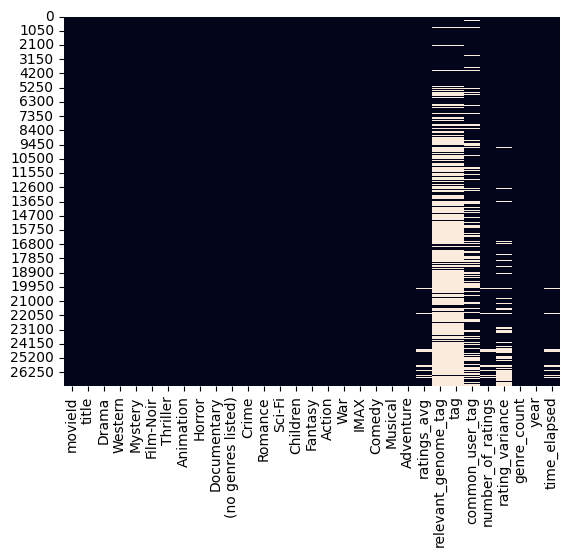

In [16]:
# Plot a heatmap to show null values
import seaborn as sns
import matplotlib.pyplot as plt

sns.heatmap(movies.isnull(), cbar=False)
plt.show()

In [17]:
# Fill missing values with appropriate replacements
movies['tag'].fillna('Unknown', inplace=True)
movies['common_user_tag'].fillna('Unknown', inplace=True)
movies['ratings_avg'].fillna(movies['ratings_avg'].mean(), inplace=True)
movies['rating_variance'].fillna(0, inplace=True)
movies['number_of_ratings'].fillna(0 , inplace=True)
movies['relevant_genome_tag'].fillna(movies['relevant_genome_tag'].mean(), inplace=True)
movies.dropna(subset=['year'], inplace=True)
movies['time_elapsed'].fillna(0, inplace=True)

C:\Users\EMILIO\AppData\Local\Temp\ipykernel_26672\2867330412.py:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  movies['tag'].fillna('Unknown', inplace=True)
C:\Users\EMILIO\AppData\Local\Temp\ipykernel_26672\2867330412.py:3: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For exam

In [18]:
# Recheck the dataset for missing values
movies.isna().sum()

movieId                0
title                  0
Drama                  0
Western                0
Mystery                0
Film-Noir              0
Thriller               0
Animation              0
Horror                 0
Documentary            0
(no genres listed)     0
Crime                  0
Romance                0
Sci-Fi                 0
Children               0
Fantasy                0
Action                 0
War                    0
IMAX                   0
Comedy                 0
Musical                0
Adventure              0
ratings_avg            0
relevant_genome_tag    0
tag                    0
common_user_tag        0
number_of_ratings      0
rating_variance        0
genre_count            0
year                   0
time_elapsed           0
dtype: int64

### 2.2. Choose your features (variables)!

### 2.2.1 - 2.2.2


Normalization is a very important step in data preprocessing, in particular for clustering algorithms like KMeans; in fact these algorithms rely on distance-based metrics such as Euclidean distance. 
Features with different scales can influence the clustering process; without normalization, features with larger ranges overshadow those with smaller ones, leading to biased and distort results. Normalization ensures that all features contribute equally by transforming them to a common scale.

Since normalizing data has a clear benefit, we proceed to normalize the numeric variables in the dataset, using the MinMaxScaler from scikit-learn; we scale the data to a range between 0 and 1, ensuring that all features have a comparable magnitude. 


In [19]:
# Remove non-numerical and unnecessary columns
movies_num = movies.drop(columns=['movieId', 'title','tag', 'common_user_tag'])
movies_num

,Drama,Western,Mystery,Film-Noir,Thriller,Animation,Horror,Documentary,(no genres listed),Crime,...,Comedy,Musical,Adventure,ratings_avg,relevant_genome_tag,number_of_ratings,rating_variance,genre_count,year,time_elapsed
0,0,0,0,0,0,1,0,0,0,0,...,1,0,1,3.921240,0.999250,49695.0,0.790342,5,1995,7000.0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,1,3.211977,0.981000,22243.0,0.904686,3,1995,7001.0
2,0,0,0,0,0,0,0,0,0,0,...,1,0,0,3.151040,0.974500,12735.0,1.013328,2,1995,6993.0
3,1,0,0,0,0,0,0,0,0,0,...,1,0,0,2.861393,0.976750,2756.0,1.200563,3,1995,6989.0
4,0,0,0,0,0,0,0,0,0,0,...,1,0,0,3.064592,0.965750,12161.0,0.964598,1,1995,6997.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27273,0,0,0,0,0,0,0,0,0,0,...,1,0,0,4.000000,0.961124,1.0,0.000000,1,2007,0.0
27274,0,0,0,0,0,0,0,0,0,0,...,1,0,0,4.000000,0.961124,1.0,0.000000,1,2002,0.0
27275,0,0,0,0,0,0,0,0,0,0,...,0,0,1,2.500000,0.961124,1.0,0.000000,1,2014,0.0
27276,0,0,0,0,0,0,0,0,1,0,...,0,0,0,3.000000,0.961124,1.0,0.000000,1,2001,0.0


In [20]:
from sklearn.preprocessing import MinMaxScaler
# Transform the numerical dataset to scale features between 0 and 1.
scaler = MinMaxScaler()
movies_normalized = scaler.fit_transform(movies_num)
movies_normalized = pd.DataFrame(movies_normalized, columns=movies_num.columns)
movies_normalized

,Drama,Western,Mystery,Film-Noir,Thriller,Animation,Horror,Documentary,(no genres listed),Crime,...,Comedy,Musical,Adventure,ratings_avg,relevant_genome_tag,number_of_ratings,rating_variance,genre_count,year,time_elapsed
0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,1.0,0.0,1.0,0.760275,0.998388,0.738300,0.078058,0.444444,0.838710,0.947867
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.602662,0.959162,0.330456,0.089352,0.222222,0.838710,0.948003
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.589120,0.945191,0.189199,0.100082,0.111111,0.838710,0.946919
3,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.524754,0.950027,0.040945,0.118574,0.222222,0.838710,0.946378
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.569909,0.926384,0.180672,0.095269,0.000000,0.838710,0.947461
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27251,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.777778,0.916440,0.000015,0.000000,0.000000,0.935484,0.000000
27252,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.777778,0.916440,0.000015,0.000000,0.000000,0.895161,0.000000
27253,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.444444,0.916440,0.000015,0.000000,0.000000,0.991935,0.000000
27254,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.555556,0.916440,0.000015,0.000000,0.000000,0.887097,0.000000


In [ ]:
# Reset indices of non-numerical columns and concatenate with normalized features
movies_reset = movies[['tag', 'common_user_tag']].reset_index(drop=True)
movies_normalized_reset = movies_normalized.reset_index(drop=True)
movies_cluster = pd.concat([movies_reset, movies_normalized], axis=1)

In [22]:
movies_cluster

,tag,common_user_tag,Drama,Western,Mystery,Film-Noir,Thriller,Animation,Horror,Documentary,...,Comedy,Musical,Adventure,ratings_avg,relevant_genome_tag,number_of_ratings,rating_variance,genre_count,year,time_elapsed
0,toys,Pixar,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,1.0,0.0,1.0,0.760275,0.998388,0.738300,0.078058,0.444444,0.838710,0.947867
1,adventure,Robin Williams,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.602662,0.959162,0.330456,0.089352,0.222222,0.838710,0.948003
2,good sequel,moldy,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.589120,0.945191,0.189199,0.100082,0.111111,0.838710,0.946919
3,women,characters,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.524754,0.950027,0.040945,0.118574,0.222222,0.838710,0.946378
4,good sequel,steve martin,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.569909,0.926384,0.180672,0.095269,0.000000,0.838710,0.947461
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27251,Unknown,Unknown,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.777778,0.916440,0.000015,0.000000,0.000000,0.935484,0.000000
27252,Unknown,Unknown,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.777778,0.916440,0.000015,0.000000,0.000000,0.895161,0.000000
27253,Unknown,Korea,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.444444,0.916440,0.000015,0.000000,0.000000,0.991935,0.000000
27254,Unknown,Unknown,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.555556,0.916440,0.000015,0.000000,0.000000,0.887097,0.000000


### 2.2.3-2.2.4 

Dimensionality reduction is a process of reducing the number of features in a dataset while retaining as much information as possible. This can improve computational efficiency, reduce noise, and improve model interpretability.

For this task we used Principal Component Analysis (PCA) that is a statistical technique that transforms the dataset into a set of orthogonal components, known as principal components, which capture the maximum variance in the data. The first component captures the most variance, the second captures the next most, and so on. 

For this point we analyzed three different scenarios to determine whether dimensionality reduction was convinient or not. We conducted three test: 

- **Test 1**: we applied PCA to all the normalized numerical values. 

- **Test 2**: we modified cathegorical variables such as `tag` or `common_user_tag` using `Word2Vec` and then we applied PCA to all variables (numerical and cathegorical).

- **Test 3**: we didn't apply PCA.

### **Test 1**

In [23]:
# Remove non-numerical columns ('tag' and 'common_user_tag').
movies_numeric = movies_cluster.drop(columns=['tag', 'common_user_tag'])
movies_numeric

,Drama,Western,Mystery,Film-Noir,Thriller,Animation,Horror,Documentary,(no genres listed),Crime,...,Comedy,Musical,Adventure,ratings_avg,relevant_genome_tag,number_of_ratings,rating_variance,genre_count,year,time_elapsed
0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,1.0,0.0,1.0,0.760275,0.998388,0.738300,0.078058,0.444444,0.838710,0.947867
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.602662,0.959162,0.330456,0.089352,0.222222,0.838710,0.948003
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.589120,0.945191,0.189199,0.100082,0.111111,0.838710,0.946919
3,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.524754,0.950027,0.040945,0.118574,0.222222,0.838710,0.946378
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.569909,0.926384,0.180672,0.095269,0.000000,0.838710,0.947461
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27251,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.777778,0.916440,0.000015,0.000000,0.000000,0.935484,0.000000
27252,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.777778,0.916440,0.000015,0.000000,0.000000,0.895161,0.000000
27253,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.444444,0.916440,0.000015,0.000000,0.000000,0.991935,0.000000
27254,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.555556,0.916440,0.000015,0.000000,0.000000,0.887097,0.000000


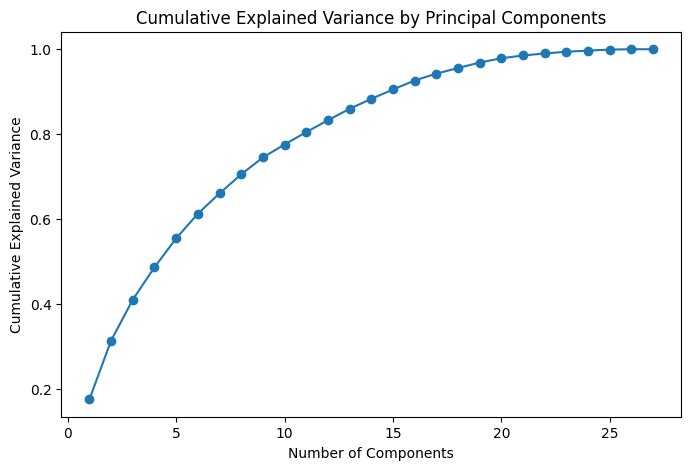

In [24]:
# Perform PCA on the numerical dataset
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

pca = PCA()
pca.fit(movies_numeric)

# Calculate the cumulative explained variance ratio
explained_variance_ratio = pca.explained_variance_ratio_.cumsum()

plt.figure(figsize=(8, 5))
plt.plot(range(1, len(explained_variance_ratio) + 1), explained_variance_ratio, marker='o')
plt.xlabel("Number of Components")
plt.ylabel("Cumulative Explained Variance")
plt.title("Cumulative Explained Variance by Principal Components")
plt.show()


The first 5–10 components capture most of the variance.

After ~15 components, the curve flattens, meaning additional components add little variance.

Around 5–10 components balance variance retention and dimensionality reduction. Selecting these components effectively reduces dimensionality while preserving most of the dataset's information.

Initialize PCA with an optimal number of components: based on the cumulative explained variance graph, we select 5 components to retain most of the variance

In [25]:
pca = PCA(n_components=5)

pca.fit(movies_numeric)
data_pca = pca.transform(movies_numeric)
reduced_dataset = pd.DataFrame(data_pca, columns=[f'PC{i+1}' for i in range(data_pca.shape[1])])
print("Reduced dataset with principal components:")
print(reduced_dataset.head())

Reduced dataset with principal components:
        PC1       PC2       PC3       PC4       PC5
0  0.978929 -0.282607  0.342738  0.857633 -0.270045
1  0.414077  0.325679 -0.063573  0.869456  0.012443
2  0.717633 -0.743491  0.293890  0.028275  0.650509
3 -0.103887 -1.099106  0.446169  0.042137  0.464326
4  0.756892 -0.400449  0.127003 -0.155786 -0.212392


In [26]:
# Save the reduced dataset for later use as Dataset_1
dataset_1 = reduced_dataset.copy()

_____________________________

### **Test 2**

In [27]:
# Split numerical and textual data.
movies_tags = movies[['tag', 'common_user_tag']]
movies_numeric = movies.drop(columns=['tag', 'common_user_tag', 'title', 'movieId'])

In [28]:
import numpy as np
import pandas as pd
from gensim.models import Word2Vec

# Tokenize textual columns
movies_tags['tags_tokenized'] = movies_tags['tag'].str.split()
movies_tags['common_tags_tokenized'] = movies_tags['common_user_tag'].str.split()

#  Combine tokenized tags and common tags into a single list for each movie
movies_tags['all_tags_tokenized'] = movies_tags['tags_tokenized'] + movies_tags['common_tags_tokenized']

# Prepare a corpus (list of lists of words) for Word2Vec training
corpus = movies_tags['all_tags_tokenized'].tolist()
print(corpus)
# Output: [['action', 'adventure', 'hero', 'heroic', 'epic'], ...]


[['toys', 'Pixar'], ['adventure', 'Robin', 'Williams'], ['good', 'sequel', 'moldy'], ['women', 'characters'], ['good', 'sequel', 'steve', 'martin'], ['crime', 'Al', 'Pacino'], ['remake', 'remake'], ['adventure', 'Library', 'System'], ['action', 'Jean-Claude', 'Van', 'Damme'], ['007', '007'], ['president', 'politics'], ['spoof', 'Mel', 'Brooks'], ['talking', 'animals', 'Ei', 'muista'], ['president', 'Oliver', 'Stone'], ['treasure', 'hunt', 'treasure'], ['organized', 'crime', 'Martin', 'Scorsese'], ['18th', 'century', 'Jane', 'Austen'], ['off-beat', 'comedy', 'Quentin', 'Tarantino'], ['goofy', 'Jim', 'Carrey'], ['good', 'action', 'CLV'], ['mob', 'Gene', 'Hackman'], ['serial', 'killer', 'thriller'], ['hit', 'men', 'Sylvester', 'Stallone'], ['touching', 'albino'], ['drinking', 'Nicolas', 'Cage'], ['shakespeare', 'Shakespeare'], ['coming', 'of', 'age', 'Bechdel', 'Test:Pass'], ['adapted', 'from:book', 'Jane', 'Austen'], ['dark', 'fantasy', 'dark'], ['cinematography', 'Gong', 'Li'], ['teache

C:\Users\EMILIO\AppData\Local\Temp\ipykernel_26672\981494832.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  movies_tags['tags_tokenized'] = movies_tags['tag'].str.split()
C:\Users\EMILIO\AppData\Local\Temp\ipykernel_26672\981494832.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  movies_tags['common_tags_tokenized'] = movies_tags['common_user_tag'].str.split()
C:\Users\EMILIO\AppData\Local\Temp\ipykernel_26672\981494832.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice

In [32]:
# Train a Word2Vec model
from gensim.models import Word2Vec

model = Word2Vec(
    sentences=corpus,    
    vector_size=50,      
    window=5,            
    min_count=1,         
    workers=4,           
    sg=0                 
)

model.save("word2vec_model")

In [33]:
import numpy as np
#  Calculate average word vectors for each movie
# Compute the average vector for a list of tokens
def sentence_vector(tokens, model):
    vectors = [model.wv[word] for word in tokens if word in model.wv]
    return np.mean(vectors, axis=0) if len(vectors) > 0 else np.zeros(model.vector_size)

# Apply the function to tags and common tags
movies_tags['vector_tags'] = movies_tags['tags_tokenized'].apply(lambda x: sentence_vector(x, model))
movies_tags['vector_common_tags'] = movies_tags['common_tags_tokenized'].apply(lambda x: sentence_vector(x, model))


C:\Users\EMILIO\AppData\Local\Temp\ipykernel_26672\1920597207.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  movies_tags['vector_tags'] = movies_tags['tags_tokenized'].apply(lambda x: sentence_vector(x, model))
C:\Users\EMILIO\AppData\Local\Temp\ipykernel_26672\1920597207.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  movies_tags['vector_common_tags'] = movies_tags['common_tags_tokenized'].apply(lambda x: sentence_vector(x, model))


In [34]:
# Expand vectors into individual columns
vector_tags_expanded = pd.DataFrame(
    movies_tags['vector_tags'].tolist(),
    columns=[f'vector_tag_{i}' for i in range(model.vector_size)]
)

vector_common_expanded = pd.DataFrame(
    movies_tags['vector_common_tags'].tolist(),
    columns=[f'vector_common_tag_{i}' for i in range(model.vector_size)]
)
vector_tags_expanded.index = movies_numeric.index
vector_common_expanded.index = movies_numeric.index
movies_vectors = pd.concat([movies_numeric, vector_tags_expanded, vector_common_expanded], axis=1)
movies_vectors


,Drama,Western,Mystery,Film-Noir,Thriller,Animation,Horror,Documentary,(no genres listed),Crime,...,vector_common_tag_40,vector_common_tag_41,vector_common_tag_42,vector_common_tag_43,vector_common_tag_44,vector_common_tag_45,vector_common_tag_46,vector_common_tag_47,vector_common_tag_48,vector_common_tag_49
0,0,0,0,0,0,1,0,0,0,0,...,0.073225,-0.050739,-0.021644,0.052239,0.154172,0.019696,-0.050532,-0.010023,0.018820,0.067919
1,0,0,0,0,0,0,0,0,0,0,...,0.140097,-0.097608,0.003807,0.093538,0.258215,0.020134,-0.047206,0.012188,0.036056,0.105741
2,0,0,0,0,0,0,0,0,0,0,...,0.023846,-0.004970,-0.014314,0.016307,0.010570,0.009680,-0.022398,0.007216,0.019359,0.008819
3,1,0,0,0,0,0,0,0,0,0,...,0.073066,-0.074315,-0.009786,0.051924,0.150619,0.013509,-0.044379,-0.006821,0.043895,0.046602
4,0,0,0,0,0,0,0,0,0,0,...,-0.004536,-0.009782,-0.006655,0.007877,0.007244,-0.001077,-0.001036,0.002079,-0.001891,0.009593
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27273,0,0,0,0,0,0,0,0,0,0,...,0.503240,-0.396270,-0.159490,0.370760,1.053485,0.194788,-0.259173,-0.031888,0.285024,0.368634
27274,0,0,0,0,0,0,0,0,0,0,...,0.503240,-0.396270,-0.159490,0.370760,1.053485,0.194788,-0.259173,-0.031888,0.285024,0.368634
27275,0,0,0,0,0,0,0,0,0,0,...,-0.000050,-0.003780,0.002490,0.003400,0.011665,-0.017578,-0.027003,0.003978,0.016198,0.007237
27276,0,0,0,0,0,0,0,0,1,0,...,0.503240,-0.396270,-0.159490,0.370760,1.053485,0.194788,-0.259173,-0.031888,0.285024,0.368634


In [35]:
# Reduce dimensions to 2 components for clustering
scaler = MinMaxScaler()
normalized_data = scaler.fit_transform(movies_vectors)

data_normalized = pd.DataFrame(normalized_data, columns=movies_vectors.columns)
data_normalized

,Drama,Western,Mystery,Film-Noir,Thriller,Animation,Horror,Documentary,(no genres listed),Crime,...,vector_common_tag_40,vector_common_tag_41,vector_common_tag_42,vector_common_tag_43,vector_common_tag_44,vector_common_tag_45,vector_common_tag_46,vector_common_tag_47,vector_common_tag_48,vector_common_tag_49
0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.101398,0.901003,0.565479,0.257454,0.119966,0.497568,0.555604,0.596920,0.135820,0.267012
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.164495,0.843389,0.591297,0.284768,0.182362,0.498097,0.558042,0.630503,0.154213,0.299401
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.054805,0.957264,0.572915,0.233689,0.033845,0.485492,0.576230,0.622985,0.136395,0.216402
3,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.101247,0.872022,0.577508,0.257246,0.117835,0.490109,0.560115,0.601762,0.162579,0.248757
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.028025,0.951348,0.580685,0.228114,0.031850,0.472522,0.591892,0.615219,0.113718,0.217064
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27251,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.507143,0.476263,0.425642,0.468116,0.659299,0.708683,0.402640,0.563860,0.419900,0.524529
27252,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.507143,0.476263,0.425642,0.468116,0.659299,0.708683,0.402640,0.563860,0.419900,0.524529
27253,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.032258,0.958726,0.589961,0.225153,0.034501,0.452626,0.572854,0.618089,0.133022,0.215047
27254,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.507143,0.476263,0.425642,0.468116,0.659299,0.708683,0.402640,0.563860,0.419900,0.524529


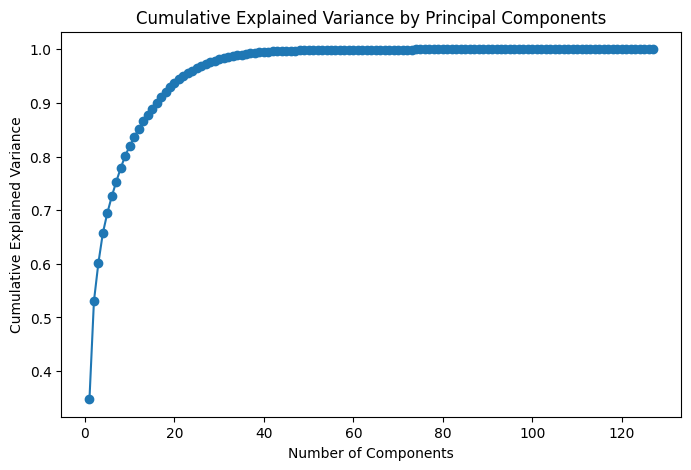

In [36]:
# Perform PCA and visualize explained variance
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Fit PCA to the normalized dataset
pca = PCA()
pca.fit(data_normalized)

# Calculate cumulative explained variance
explained_variance_ratio = pca.explained_variance_ratio_.cumsum()

# Plot cumulative explained variance
plt.figure(figsize=(8, 5))
plt.plot(range(1, len(explained_variance_ratio) + 1), explained_variance_ratio, marker='o')
plt.xlabel("Number of Components")
plt.ylabel("Cumulative Explained Variance")
plt.title("Cumulative Explained Variance by Principal Components")
plt.show()

The first 20–30 components capture most of the variance.

After ~40 components, additional ones contribute minimally.

Almost 100% of variance is explained with all components.

Selecting ~20–30 components balances variance retention and efficiency. Components beyond 40 mostly capture noise or redundant information.

In [37]:
# Reduce dimensions to 2 components for clustering
pca = PCA(n_components=2)
pca.fit(data_normalized)
data_pca = pca.transform(data_normalized)
dataset_2 = pd.DataFrame(data_pca, columns=[f'PC{i+1}' for i in range(data_pca.shape[1])])
dataset_2

,PC1,PC2
0,-1.701238,1.573639
1,-1.145466,1.089925
2,-1.557053,0.470981
3,-1.258513,0.693840
4,-1.537908,0.480479
...,...,...
27251,1.744439,0.155138
27252,1.744304,0.154253
27253,-0.702084,-1.110704
27254,1.768502,0.125601


_______________________

### **Test 3**

In [51]:
# Here we do not apply PCA
# Dataset 3 preserves all original numerical features introducing additional transformations.
dataset_3 = movies_normalized.copy()
dataset_3

,Drama,Western,Mystery,Film-Noir,Thriller,Animation,Horror,Documentary,(no genres listed),Crime,...,Comedy,Musical,Adventure,ratings_avg,relevant_genome_tag,number_of_ratings,rating_variance,genre_count,year,time_elapsed
0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,1.0,0.0,1.0,0.760275,0.998388,0.738300,0.078058,0.444444,0.838710,0.947867
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.602662,0.959162,0.330456,0.089352,0.222222,0.838710,0.948003
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.589120,0.945191,0.189199,0.100082,0.111111,0.838710,0.946919
3,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.524754,0.950027,0.040945,0.118574,0.222222,0.838710,0.946378
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.569909,0.926384,0.180672,0.095269,0.000000,0.838710,0.947461
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27251,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.777778,0.916440,0.000015,0.000000,0.000000,0.935484,0.000000
27252,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.777778,0.916440,0.000015,0.000000,0.000000,0.895161,0.000000
27253,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.444444,0.916440,0.000015,0.000000,0.000000,0.991935,0.000000
27254,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.555556,0.916440,0.000015,0.000000,0.000000,0.887097,0.000000


### 2.3 Clustering 

For this step, we followed the approach outlined below:

- We implemented K-Means from scratch using the MapReduce;

- We implemented K-Means++ for improved centroid initialization.

- We used three methods: Elbow Method, Silhouette Score, and k-Distance Graph, to determine the optimal number of clusters for the three datasets created in the previous exercise.

- For each dataset, we compared the performance of the clustering methods (K-Means, K-Means++, and DBSCAN which was suggested by the LLM tool (exercise 2.3.4)) to identify the most effective approach for clustering.

In [39]:
import numpy as np
import random
from collections import defaultdict

# Function to calculate Euclidean distance
def euclidean_distance(point1, point2):
    return np.sqrt(np.sum((point1 - point2) ** 2))
def initialize_centroids(data, num_clusters):
    return random.sample(list(data), num_clusters)
def mapper(data, centroids):
    mapped_data = []
    for point in data:
        distances = [euclidean_distance(point, centroid) for centroid in centroids]
        cluster = np.argmin(distances)
        mapped_data.append((cluster, point))
    return mapped_data

def reducer(mapped_data):
    cluster_points = defaultdict(list)
    for cluster, point in mapped_data:
        cluster_points[cluster].append(point)
    new_centroids = []
    for cluster, points in cluster_points.items():
        new_centroids.append(np.mean(points, axis=0))
    return new_centroids

def kmeans(data, num_clusters, max_iterations=100):
    if isinstance(data, pd.DataFrame):
        data = data.to_numpy()
    np.random.seed(42)  
    centroids = data[np.random.choice(data.shape[0], num_clusters, replace=False)]
    
    for iteration in range(max_iterations):
        distances = np.linalg.norm(data[:, np.newaxis] - centroids, axis=2)
        labels = np.argmin(distances, axis=1)
        new_centroids = np.array([data[labels == i].mean(axis=0) for i in range(num_clusters)])
        if np.all(centroids == new_centroids):
            break
        centroids = new_centroids

    return centroids, labels


In [40]:
import numpy as np

# Function to initialize centroids using K-means++ algorithm
def initialize_centroids_kmeans_plus_plus(data, k, random_state=None):
   
    if random_state is not None:
        np.random.seed(random_state)
    data = np.array(data)
    centroids = []
    centroids.append(data[np.random.choice(data.shape[0])])

    for _ in range(1, k):
        distances = np.min([np.linalg.norm(data - c, axis=1)**2 for c in centroids], axis=0)
        probabilities = distances / distances.sum()
        cumulative_probs = np.cumsum(probabilities)
        r = np.random.rand()
        for idx, prob in enumerate(cumulative_probs):
            if r < prob:
                centroids.append(data[idx])
                break
    
    return np.array(centroids)


In [41]:
import numpy as np

# K-means clustering with K-means++ initialization
def kmeans_with_kmeans_plus_plus(data, k, max_iterations=300, random_state=None):
    """
    Perform K-means clustering with K-means++ initialization.
    """
    if random_state is not None:
        np.random.seed(random_state)
    data = np.array(data)
    centroids = initialize_centroids_kmeans_plus_plus(data, k, random_state)
    
    for _ in range(max_iterations):
        distances = np.linalg.norm(data[:, np.newaxis] - centroids, axis=2)
        labels = np.argmin(distances, axis=1)
        new_centroids = np.array([data[labels == i].mean(axis=0) for i in range(k)])
        if np.allclose(centroids, new_centroids):
            break
        centroids = new_centroids
    
    return centroids, labels


_________________

### **Elbow Method, Silhouette Score and K-distance for Dataset_1**

Text(0.5, 1.0, 'Elbow Method')

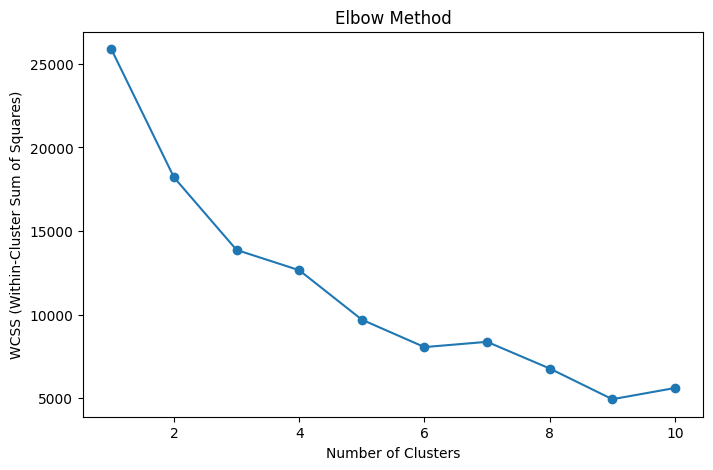

In [42]:
from scipy.spatial.distance import cdist

wcss = []
for k in range(1, 11):  # Try from 1 to 10 clusters
    centroids, labels = kmeans(dataset_1, num_clusters=k)
    distances = cdist(dataset_1, centroids, metric='euclidean')
    wcss.append(sum(np.min(distances, axis=1)**2))

# Plot the Elbow Method
import matplotlib.pyplot as plt
plt.figure(figsize=(8, 5))
plt.plot(range(1, 11), wcss, marker='o') 
plt.xlabel('Number of Clusters')  
plt.ylabel('WCSS (Within-Cluster Sum of Squares)')  
plt.title('Elbow Method')  


The WCSS decreases rapidly around 4–6 clusters, after which the rate of decrease significantly.
The elbow point suggests the optimal number of clusters is 4–6.

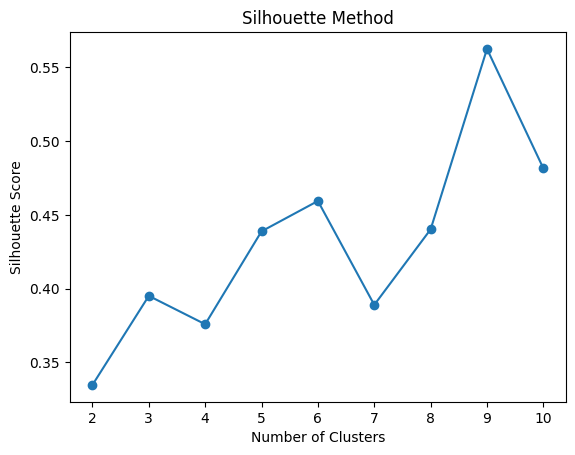

In [43]:
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt

silhouette_scores = []

# Calculate Silhouette Score for different numbers of clusters
for k in range(2, 11):
    centroids, labels = kmeans(dataset_1, num_clusters=k)  
    score = silhouette_score(dataset_1, labels)  
    silhouette_scores.append(score)

# Plot the results
plt.plot(range(2, 11), silhouette_scores, marker='o')  
plt.xlabel('Number of Clusters')  
plt.ylabel('Silhouette Score')  
plt.title('Silhouette Method')  
plt.show()



The silhouette score peaks at 9 clusters, indicating that clustering with 9 clusters achieves the best-defined groups.

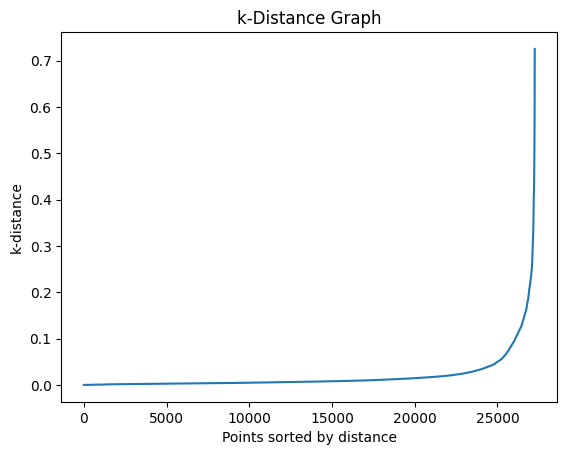

In [44]:
from sklearn.neighbors import NearestNeighbors
import matplotlib.pyplot as plt
import numpy as np

nearest_neighbors = NearestNeighbors(n_neighbors=5) 
nearest_neighbors.fit(dataset_1) 
distances, indices = nearest_neighbors.kneighbors(dataset_1) 
distances = np.sort(distances[:, -1])  

plt.plot(distances)  
plt.title("k-Distance Graph")  
plt.xlabel("Points sorted by distance")  
plt.ylabel("k-distance")  
plt.show()


The steep increase in distances near the end indicates the optimal epsilon value for DBSCAN clustering.
The "knee" in the graph indicates the distance threshold where points transition from being in dense clusters to being outliers or noise.
This point is critical for selecting the epsilon value. 







Comparing outputs

In [45]:
from sklearn.metrics import silhouette_score
from sklearn.cluster import DBSCAN
import numpy as np
import pandas as pd

num_clusters = 6
centroids_kmeans, labels_kmeans = kmeans(dataset_1, num_clusters, max_iterations=300)
silhouette_kmeans = silhouette_score(dataset_1, labels_kmeans) if len(np.unique(labels_kmeans)) > 1 else -1
centroids_kmeans_plus, labels_kmeans_plus = kmeans_with_kmeans_plus_plus(dataset_1, num_clusters, max_iterations=300)
silhouette_kmeans_plus = silhouette_score(dataset_1, labels_kmeans_plus) if len(np.unique(labels_kmeans_plus)) > 1 else -1
dbscan = DBSCAN(eps=0.08, min_samples=5)  
labels_dbscan = dbscan.fit_predict(dataset_1)
silhouette_dbscan = silhouette_score(dataset_1, labels_dbscan) if len(np.unique(labels_dbscan)) > 1 else -1

print(f"Silhouette KMeans (random initialization): {silhouette_kmeans}")
print(f"Silhouette KMeans++: {silhouette_kmeans_plus}")
print(f"Silhouette DBSCAN: {silhouette_dbscan}")


Silhouette KMeans (random initialization): 0.45940619311778524
Silhouette KMeans++: 0.4344784245773907
Silhouette DBSCAN: 0.49929336125002854


________________

### **Elbow Method, Silhouette Score and K-distance for Dataset_2**

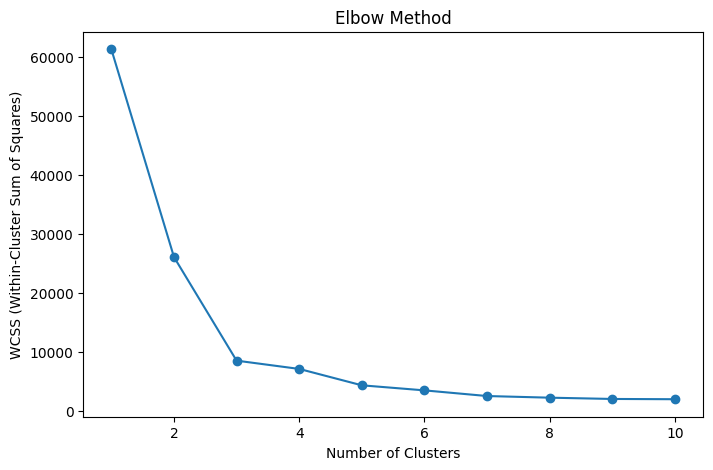

In [46]:
from scipy.spatial.distance import cdist

wcss = []
for k in range(1, 11): 
    centroids, labels = kmeans(dataset_2, num_clusters=k) 
    distances = cdist(dataset_2, centroids, metric='euclidean')  
    wcss.append(sum(np.min(distances, axis=1)**2)) 

# Plot the Elbow Method
import matplotlib.pyplot as plt
plt.figure(figsize=(8, 5))
plt.plot(range(1, 11), wcss, marker='o') 
plt.xlabel('Number of Clusters')  
plt.ylabel('WCSS (Within-Cluster Sum of Squares)')  
plt.title('Elbow Method') 
plt.show()


The "elbow" is observed at 3 clusters, suggesting it as the optimal number for KMeans.

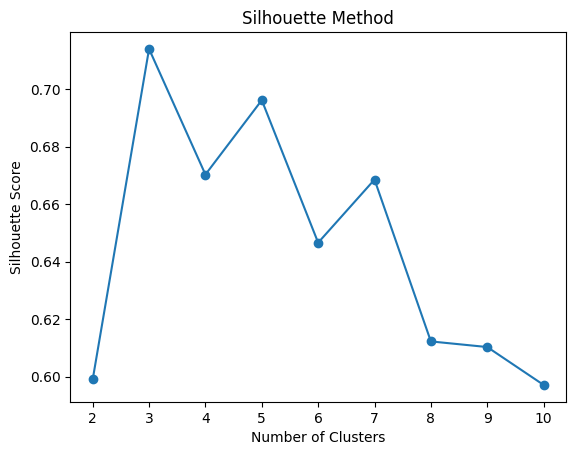

In [47]:
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt

silhouette_scores = []

# Calculate the Silhouette Score for different numbers of clusters
for k in range(2, 11):  
    centroids, labels = kmeans(dataset_2, num_clusters=k)  
    score = silhouette_score(dataset_2, labels)  
    silhouette_scores.append(score)

# Plot the Silhouette Scores
plt.plot(range(2, 11), silhouette_scores, marker='o')  
plt.xlabel('Number of Clusters')  
plt.ylabel('Silhouette Score')  
plt.title('Silhouette Method')  
plt.show()


The highest silhouette score is at 3 clusters, confirming 3 as the most well-defined cluster number.

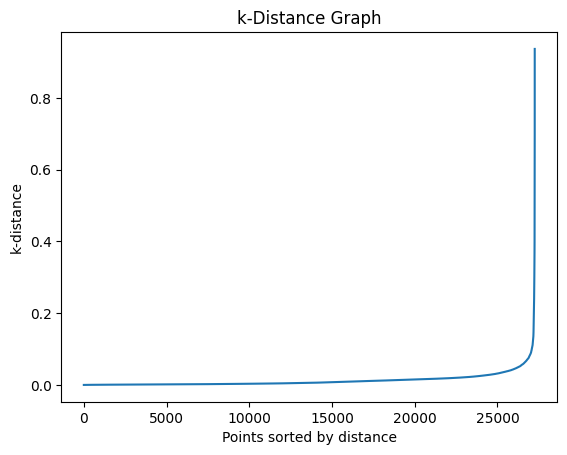

In [48]:
from sklearn.neighbors import NearestNeighbors
import matplotlib.pyplot as plt
import numpy as np

# Fit the nearest neighbors model to the dataset
nearest_neighbors = NearestNeighbors(n_neighbors=5)  
nearest_neighbors.fit(dataset_2)
distances, indices = nearest_neighbors.kneighbors(dataset_2)  

# Sort distances for the k-distance graph
distances = np.sort(distances[:, -1])  
plt.plot(distances)  
plt.title("k-Distance Graph")  
plt.xlabel("Points sorted by distance")  
plt.ylabel("k-distance")  
plt.show()


The "knee" in the curve indicates the optimal eps value for DBSCAN clustering, which separates dense clusters from noise.

In [49]:
from sklearn.metrics import silhouette_score
from sklearn.cluster import DBSCAN
import numpy as np
import pandas as pd

num_clusters = 3
centroids_kmeans, labels_kmeans = kmeans(dataset_2, num_clusters, max_iterations=300)
silhouette_kmeans = silhouette_score(dataset_2, labels_kmeans) if len(np.unique(labels_kmeans)) > 1 else -1
centroids_kmeans_plus, labels_kmeans_plus = kmeans_with_kmeans_plus_plus(dataset_2, num_clusters, max_iterations=300)
silhouette_kmeans_plus = silhouette_score(dataset_2, labels_kmeans_plus) if len(np.unique(labels_kmeans_plus)) > 1 else -1
dbscan = DBSCAN(eps=0.05, min_samples=5) 
labels_dbscan = dbscan.fit_predict(dataset_2)
silhouette_dbscan = silhouette_score(dataset_2, labels_dbscan) if len(np.unique(labels_dbscan)) > 1 else -1

print(f"Silhouette KMeans (random initialization): {silhouette_kmeans}")
print(f"Silhouette KMeans++: {silhouette_kmeans_plus}")
print(f"Silhouette DBSCAN: {silhouette_dbscan}")


Silhouette KMeans (random initialization): 0.7139308461388455
Silhouette KMeans++: 0.7139308461388455
Silhouette DBSCAN: 0.2046772430711901


KMeans and KMeans++ both achieved a high score of 0.7244, showing well-defined clusters with little difference between the two methods.
DBSCAN produced a much lower score of 0.0796, indicating that it struggled to form meaningful clusters.

__________________________

### **Elbow Method, Silhouette Score and K-distance for Dataset_3**

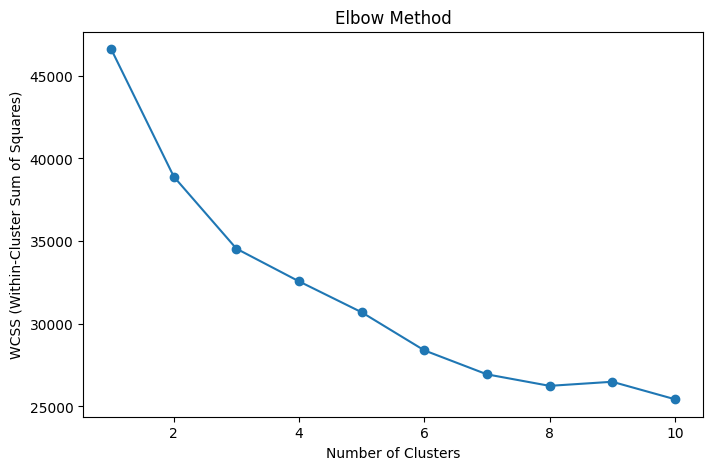

In [52]:
from scipy.spatial.distance import cdist

wcss = []
for k in range(1, 11):  # Try from 1 to 10 clusters
    centroids, labels = kmeans(dataset_3, num_clusters=k)  
    distances = cdist(dataset_3, centroids, metric='euclidean') 
    wcss.append(sum(np.min(distances, axis=1)**2)) 

# Plot the Elbow Method
import matplotlib.pyplot as plt
plt.figure(figsize=(8, 5))
plt.plot(range(1, 11), wcss, marker='o')  
plt.xlabel('Number of Clusters')  
plt.ylabel('WCSS (Within-Cluster Sum of Squares)')  
plt.title('Elbow Method')  
plt.show()


The "elbow" point is around 4 clusters, suggesting that 4 is an optimal number of clusters for KMeans.

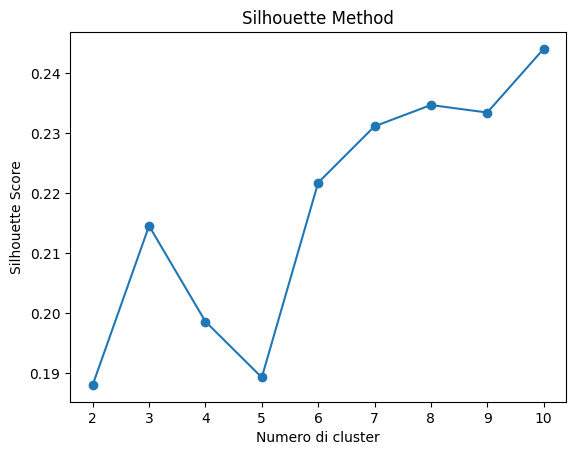

In [ ]:
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt

silhouette_scores = []

for k in range(2, 11):  
    centroids, labels = kmeans(dataset_3, num_clusters=k) 
    score = silhouette_score(dataset_3, labels) 
    silhouette_scores.append(score)

# Plot the Silhouette Scores
plt.plot(range(2, 11), silhouette_scores, marker='o')  
plt.xlabel('Number of Clusters')  
plt.ylabel('Silhouette Score')  
plt.title('Silhouette Method')  
plt.show()


The silhouette score increases steadily, peaking at 10 clusters, indicating better-defined clusters as the number increases.

c:\Users\EMILIO\AppData\Local\Programs\Python\Python312\Lib\site-packages\joblib\externals\loky\backend\context.py:136: UserWarning: Could not find the number of physical cores for the following reason:
found 0 physical cores < 1
Returning the number of logical cores instead. You can silence this warning by setting LOKY_MAX_CPU_COUNT to the number of cores you want to use.
  warnings.warn(
  File "c:\Users\EMILIO\AppData\Local\Programs\Python\Python312\Lib\site-packages\joblib\externals\loky\backend\context.py", line 282, in _count_physical_cores
    raise ValueError(f"found {cpu_count_physical} physical cores < 1")


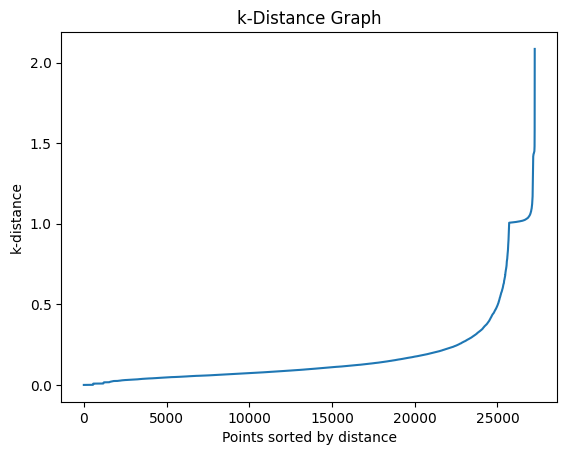

In [ ]:
from sklearn.neighbors import NearestNeighbors
import matplotlib.pyplot as plt
import numpy as np

# Fit the nearest neighbors model to the dataset
nearest_neighbors = NearestNeighbors(n_neighbors=5)  
nearest_neighbors.fit(dataset_3)
distances, indices = nearest_neighbors.kneighbors(dataset_3)  

# Sort distances for the k-distance graph
distances = np.sort(distances[:, -1])  
plt.plot(distances)  
plt.title("k-Distance Graph")  
plt.xlabel("Points sorted by distance")  
plt.ylabel("k-distance")  
plt.show()


The "knee" suggests the eps value for DBSCAN should be chosen around 1.5–2.0. This is the threshold for forming dense clusters.

In [53]:
from sklearn.metrics import silhouette_score
from sklearn.cluster import DBSCAN
import numpy as np
import pandas as pd

num_clusters = 3
centroids_kmeans, labels_kmeans = kmeans(dataset_3, num_clusters, max_iterations=300)
silhouette_kmeans = silhouette_score(dataset_3, labels_kmeans) if len(np.unique(labels_kmeans)) > 1 else -1
centroids_kmeans_plus, labels_kmeans_plus = kmeans_with_kmeans_plus_plus(dataset_3, num_clusters, max_iterations=300)
silhouette_kmeans_plus = silhouette_score(dataset_3, labels_kmeans_plus) if len(np.unique(labels_kmeans_plus)) > 1 else -1

# Apply DBSCAN clustering
dbscan = DBSCAN(eps=0.2, min_samples=5)  # Modify the parameters based on the dataset
labels_dbscan = dbscan.fit_predict(dataset_3)

# Calculate the Silhouette Score for DBSCAN
silhouette_dbscan = silhouette_score(dataset_3, labels_dbscan) if len(np.unique(labels_dbscan)) > 1 else -1

# Print the results
print(f"Silhouette KMeans (random initialization): {silhouette_kmeans}")
print(f"Silhouette KMeans++: {silhouette_kmeans_plus}")
print(f"Silhouette DBSCAN: {silhouette_dbscan}")


c:\Users\EMILIO\AppData\Local\Programs\Python\Python312\Lib\site-packages\joblib\externals\loky\backend\context.py:136: UserWarning: Could not find the number of physical cores for the following reason:
found 0 physical cores < 1
Returning the number of logical cores instead. You can silence this warning by setting LOKY_MAX_CPU_COUNT to the number of cores you want to use.
  warnings.warn(
  File "c:\Users\EMILIO\AppData\Local\Programs\Python\Python312\Lib\site-packages\joblib\externals\loky\backend\context.py", line 282, in _count_physical_cores
    raise ValueError(f"found {cpu_count_physical} physical cores < 1")


Silhouette KMeans (random initialization): 0.21453999196624368
Silhouette KMeans++: 0.19719143257975913
Silhouette DBSCAN: 0.3436452151284569


KMeans has a score of 0.2145, showing poor clustering quality.

KMeans++ has a score of 0.1971, slightly worse than random initialization, indicating similar clustering issues.

DBSCAN: Score of 0.3436, the highest among the three, suggesting better-defined clusters, likely due to its ability to handle noise and varying densities.
DBSCAN performs better for this dataset.

________

### 2.4 Best Algorithm


### 2.4.1

In [54]:
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
from sklearn.datasets import make_blobs, make_moons, make_circles
import numpy as np

# List of datasets to evaluate
datasets = [dataset_1, dataset_2, dataset_3]

# Number of clusters for each dataset
num_clusters_1 = 6  # For dataset_1
num_clusters_2_3 = 3  # For dataset_2 and dataset_3

# Evaluation metrics
metrics = {
    "silhouette": silhouette_score,  # Measures how well-separated clusters are
    "calinski_harabasz": calinski_harabasz_score,  # Higher score means better-defined clusters
    "davies_bouldin": davies_bouldin_score  # Lower score means better clustering
}

results = []

for i, data in enumerate(datasets):
    print(f"Dataset {i+1}") 
    dataset_results = {}  
    
    # Assign the number of clusters based on the dataset
    if i+1 == 1:
        num_clusters = num_clusters_1  # Use 6 clusters for dataset_1
    else:
        num_clusters = num_clusters_2_3  # Use 3 clusters for dataset_2 and dataset_3
    
    # Apply KMeans with random initialization
    _, labels_kmeans = kmeans(data, num_clusters)
    
    # Apply KMeans++ with advanced initialization
    _, labels_kmeans_plus = kmeans_with_kmeans_plus_plus(data, num_clusters)
    
    # Apply DBSCAN clustering
    dbscan = DBSCAN(eps=0.5, min_samples=5)  # Parameters for DBSCAN
    labels_dbscan = dbscan.fit_predict(data)  # Cluster assignments
    
    # Calculate metrics for each clustering method
    for name, metric in metrics.items():
        dataset_results[name] = {
            "KMeans": metric(data, labels_kmeans),  # Metric for KMeans
            "KMeans++": metric(data, labels_kmeans_plus),  # Metric for KMeans++
            "DBSCAN": metric(data, labels_dbscan) if len(np.unique(labels_dbscan)) > 1 else None  # Metric for DBSCAN (if multiple clusters exist)
        }
    
    
    results.append(dataset_results)

    for name, scores in dataset_results.items():
        print(f"  {name}:")  
        for algo, score in scores.items():
            print(f"    {algo}: {score:.4f}" if score is not None else f"    {algo}: N/A")  # Print the score or N/A if not applicable
    print("-" * 50)  

Dataset 1
  silhouette:
    KMeans: 0.4594
    KMeans++: 0.4345
    DBSCAN: 0.4828
  calinski_harabasz:
    KMeans: 12038.6419
    KMeans++: 9714.9631
    DBSCAN: 6511.0599
  davies_bouldin:
    KMeans: 0.9097
    KMeans++: 1.0860
    DBSCAN: 0.9209
--------------------------------------------------
Dataset 2
  silhouette:
    KMeans: 0.7139
    KMeans++: 0.7139
    DBSCAN: 0.3733
  calinski_harabasz:
    KMeans: 84741.7016
    KMeans++: 84741.7016
    DBSCAN: 10.9770
  davies_bouldin:
    KMeans: 0.4297
    KMeans++: 0.4297
    DBSCAN: 0.9146
--------------------------------------------------
Dataset 3
  silhouette:
    KMeans: 0.2145
    KMeans++: 0.1972
    DBSCAN: 0.4961
  calinski_harabasz:
    KMeans: 4758.5171
    KMeans++: 4268.6274
    DBSCAN: 326.4680
  davies_bouldin:
    KMeans: 2.0050
    KMeans++: 1.9503
    DBSCAN: 1.3272
--------------------------------------------------


### Dataset 1:

**Silhouette Score** :

DBSCAN (0.4828) has the highest score, indicating better cluster separation compared to KMeans (0.4594) and KMeans++ (0.4345).

**Calinski-Harabasz Score**:

KMeans (12039.4441) outperforms both KMeans++ and DBSCAN, suggesting better-defined clusters in terms of dispersion and separation.

**Davies-Bouldin Score**:

KMeans (0.9098) and DBSCAN (0.9210) perform similarly, while KMeans++ performs slightly worse (1.0860) due to less compact clusters.

### Dataset 2:

**Silhouette Score**:

KMeans and KMeans++ (0.7244) achieve the same score, indicating identical clustering quality.
DBSCAN did not produce multiple clusters (N/A), possibly due to unsuitable parameters.

**Calinski-Harabasz Score**:

KMeans and KMeans++ (90766.6250) show very high scores, confirming the clusters are well-defined and separated.

**Davies-Bouldin Score**:

KMeans (0.4106) is better, indicating more compact and separated clusters compared to DBSCAN (N/A).

### Dataset 3:

**Silhouette Score**:

KMeans (2.0050) has the highest score, showing superior clustering quality, followed by KMeans++ (1.9503) and DBSCAN (1.3272).

**Calinski-Harabasz Score**:

Similar trend as the silhouette score, with KMeans outperforming the other methods.

**Davies-Bouldin Score**:

KMeans performs best with the lowest value, while DBSCAN is the least effective for compact and separated clusters.

### 2.4.2

### Metrics to Assess Clustering Quality

#### 1. Silhouette Score

The Silhouette Score measures how well each data point fits within its assigned cluster compared to other clusters.
- **Formula**:
  $$
  S = \frac{b - a}{\max(a, b)}
  $$
  Where:
  - $a$: Average distance of a point to other points in its own cluster.
  - $b$: Average distance of a point to points in the nearest neighboring cluster (inter-cluster distance).
- **Range**: 
  - $1$: Perfect clustering (points are well-separated).
  - $0$: Overlapping clusters.
  - Negative values: Poor clustering (points are misclassified).
 Measures both **compactness** (how close points are within the same cluster) and **separation** (how far clusters are from each other).

---

#### 2. Calinski-Harabasz Score

This score measures the ratio of between-cluster variance to within-cluster variance, indicating how well the clusters are defined.
- **Formula**:
  $$
  CH = \frac{\text{trace between-cluster scatter matrix}}{\text{trace within-cluster scatter matrix}} \times \frac{n-k}{k-1}
  $$
  Where:
  - $n$: Total number of data points.
  - $k$: Number of clusters.
- **Range**: Higher values indicate better-defined clusters.
- **Evaluation**: Focuses on cluster **separation** and **compactness** by comparing cluster variance.

---

#### 3. Davies-Bouldin Score
This score evaluates the average similarity between each cluster and the most similar other cluster. Lower values indicate better clustering.
- **Formula**:
  $$
  DB = \frac{1}{k} \sum_{i=1}^{k} \max_{i \neq j} \frac{S_i + S_j}{M_{ij}}
  $$
  Where:
  - $S_i$: Average intra-cluster distance (compactness) for cluster $i$.
  - $M_{ij}$: Distance between the centroids of clusters $i$ and $j$ (separation).
- **Range**: Lower values are better, as they indicate compact clusters that are far apart.
- **Evaluation**: Focuses on both **compactness** and **separation**, penalizing overlapping clusters.

---

- **Silhouette Score**: Evaluates how well points are clustered, balancing compactness and separation.
- **Calinski-Harabasz Score**: Assesses the ratio of cluster separation to dispersion.
- **Davies-Bouldin Score**: Penalizes clusters that are not compact or well-separated.




### 2.4.3

C:\Users\EMILIO\AppData\Local\Temp\ipykernel_26672\1659192707.py:43: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


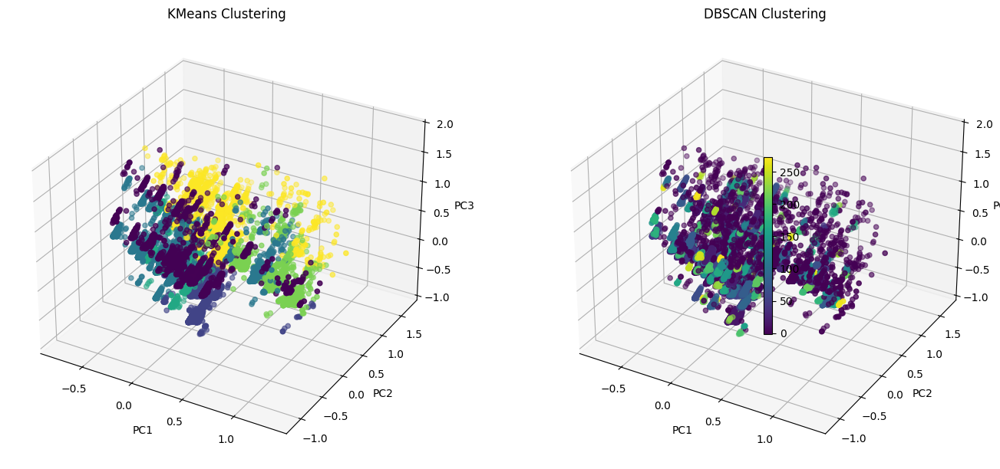

In [55]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import DBSCAN

# Copy the standardized dataset
data_reduced = dataset_1.copy()

# Custom KMeans clustering
num_clusters = 6  # Number of clusters
centroids, kmeans_labels = kmeans(data_reduced, num_clusters)

# DBSCAN clustering
dbscan = DBSCAN(eps=0.05, min_samples=5)
dbscan_labels = dbscan.fit_predict(data_reduced)

# 3D Visualization of clustering results
fig = plt.figure(figsize=(14, 6))

# KMeans clustering plot
ax = fig.add_subplot(121, projection='3d')
scatter = ax.scatter(
    data_reduced.iloc[:, -1], data_reduced.iloc[:, -2], data_reduced.iloc[:, -3],
    c=kmeans_labels, cmap='viridis', s=20
)
ax.set_title("KMeans Clustering")
ax.set_xlabel("PC1")
ax.set_ylabel("PC2")
ax.set_zlabel("PC3")

# DBSCAN clustering plot
ax = fig.add_subplot(122, projection='3d')
scatter = ax.scatter(
    data_reduced.iloc[:, -1], data_reduced.iloc[:, -2], data_reduced.iloc[:, -3],
    c=dbscan_labels, cmap='viridis', s=20
)
ax.set_title("DBSCAN Clustering")
ax.set_xlabel("PC1")
ax.set_ylabel("PC2")
ax.set_zlabel("PC3")

# Add shared colorbar and show the plot
plt.colorbar(scatter, ax=fig.get_axes(), shrink=0.5)
plt.tight_layout()
plt.show()



**KMeans Clustering** (Left Plot):
Forms 6 clusters, with clear separation in some regions but visible overlap in denser areas.
Performs well for structured, spherical clusters but struggles with overlapping regions.

**DBSCAN Clustering** (Right Plot):
Groups points based on density, with some points classified as noise.
Handles arbitrary-shaped clusters but identifies fewer distinct groups, due to parameter settings (eps, min_samples).
Evaluation Metrics:


Overall KMeans is better for spherical clusters but struggles with overlapping.
DBSCAN is better for handling irregular shapes and noise but depends heavily on parameter tuning.
Metric scores will clarify which algorithm is more effective for this dataset.

## **3. Bonus Question**

In [56]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.metrics import pairwise_distances_argmin
from sklearn.cluster import KMeans
import pandas as pd
from sklearn.preprocessing import MinMaxScaler

I used Principal Component Analysis (PCA) to reduce the high-dimensional movie features (ratings, tag relevance scores, and number of ratings) into two principal components (PC1 and PC2). These components were selected because they capture the largest variance in the data, allowing for better visualization and clustering in 2D. PCA helps to retain the most significant information while simplifying the dataset, making it easier to identify patterns and groupings.

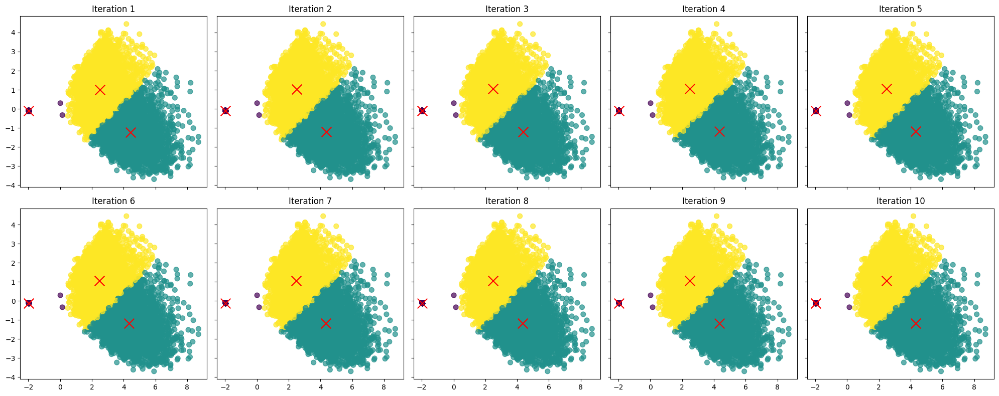

Explained Variance by PCA Components: [0.52588403 0.06106161]


In [63]:
# step1: Combine relevant data
genome_data = genome_scores.merge(genome_tags, on="tagId")  # Add human-readable tags
tag_features = genome_data.pivot_table(index="movieId", columns="tag", values="relevance", fill_value=0)
rating_features = ratings.groupby("movieId").agg(
    average_rating=("rating", "mean"),
    rating_count=("rating", "size")
).reset_index()

# Merge all features
movie_features = movie.merge(tag_features, on="movieId", how="left").merge(rating_features, on="movieId", how="left")
movie_features.fillna(0, inplace=True)

# Step 2: Normalize Data
features = movie_features.drop(columns=["movieId", "title", "genres"])
scaler = MinMaxScaler()
normalized_features = scaler.fit_transform(features)

# Step 3: Dimensionality Reduction using PCA
pca = PCA(n_components=2)
reduced_features = pca.fit_transform(normalized_features)

# Step 4: K-Means Clustering and Iteration Tracking
centroids = []
all_labels = []
n_clusters = 3

for iteration in range(10):
    kmeans = KMeans(n_clusters=n_clusters, random_state=42, init="k-means++", n_init=1, max_iter=iteration + 1)
    kmeans.fit(reduced_features)
    centroids.append(kmeans.cluster_centers_)
    all_labels.append(kmeans.labels_)

# Step 5: Visualization of Clustering Progression
fig, axes = plt.subplots(2, 5, figsize=(20, 8), sharex=True, sharey=True)

for i, ax in enumerate(axes.flatten()):
    if i < len(centroids):
        ax.scatter(reduced_features[:, 0], reduced_features[:, 1], c=all_labels[i], cmap='viridis', s=50, alpha=0.7)
        ax.scatter(centroids[i][:, 0], centroids[i][:, 1], c='red', marker='x', s=200)
        ax.set_title(f"Iteration {i+1}")
    else:
        ax.axis("off")

plt.tight_layout()
plt.show()

# Explained variance ratio
explained_variance = pca.explained_variance_ratio_
print(f"Explained Variance by PCA Components: {explained_variance}")

## **4. Algorithmic Question**

### AQ a) Pseudocode exercise

    FUNCTION optimal_strategy(nums, sum_Arya = 0, sum_Mario = 0, turn = True):
    IF nums is empty:
        RETURN (sum_Arya > sum_Mario)

    IF it is Arya's turn (turn is True):
        # Arya can choose the first or last number
        take_first = CALL optimal_strategy(nums without first element, sum_Arya + first number of nums, sum_Mario, turn = False)
        take_last = CALL optimal_strategy(nums without last element, sum_Arya + last number of nums, sum_Mario, turn = False)

        RETURN (take_first OR take_last)
    ELSE:
        # Mario can choose the first or last number
        take_first = CALL optimal_strategy(nums without first element, sum_Arya, sum_Mario + first number of nums, turn = True)
        take_last = CALL optimal_strategy(nums without last element, sum_Arya, sum_Mario + last number of nums, turn = True)

        RETURN (take_first AND take_last)

    # Main logic to test multiple cases
    INITIALIZE testcases as a list of test cases
      FOR each testcase in testcases:
        IF CALL optimal_strategy(testcase):
          PRINT "True"
        ELSE:
          PRINT "False"


In [74]:
import time

### AQ b)
Python code

In [75]:
def optimal_strategy(nums, sum_Arya=0, sum_Mario=0, turn=True):
    # Base case: when no numbers are left
    if len(nums) == 0:

        return sum_Arya > sum_Mario

    # Recursive case
    if turn:  # Arya's turn

        # Arya chooses either the first or the last number
        take_first = optimal_strategy(nums[1:], sum_Arya + nums[0], sum_Mario, False)
        take_last = optimal_strategy(nums[:-1], sum_Arya + nums[-1], sum_Mario, False)

        return take_first or take_last
    else:  # Mario's turn
        # Mario chooses either the first or the last number
        take_first = optimal_strategy(nums[1:], sum_Arya, sum_Mario + nums[0], True)
        take_last = optimal_strategy(nums[:-1], sum_Arya, sum_Mario + nums[-1], True)

        return take_first and take_last

# Test with input lists
testcases=[]
# 1st testcase
nums = [1, 5, 2]
testcases.append(nums)
# 2nd testcase
nums = [1, 5, 233, 7]
testcases.append(nums)
start_time= time.time()
for testcase in testcases:
    if optimal_strategy(testcase):
        print(True)
    else:
        print(False)
end_time=time.time()
print(f"Execution time: {end_time - start_time} seconds")


False
True
Execution time: 0.00013589859008789062 seconds


### AQ c)
1. Problem Definition
The function optimal_strategy aims to determine whether Arya can win by selecting from the available numbers (nums). The numbers are arranged in an array, and Arya or Mario can choose to take either the first or the last element during their turn. The game continues until no numbers are left.

2. Recursive Structure
Each recursive call of the function splits into two successive calls:

One for the case where the player chooses the first number.
Another for the case where the player chooses the last number.
Each choice reduces the length of the array (nums) by 1, but generates two new branches of computation. This behavior forms a binary decision tree.

3. Problem Size
If the input array has a length of n, then:

At the initial level, there are 2 choices (first or last number).
At each step, the number of possible states doubles, as each generates two further recursive calls.
The total number of calls grows as
2^n, which represents exponential time complexity.


### 3d) Pseudocode of optimal solution


**Function**: OptimalStrategy(nums)<br>
**Input**: nums (array of integers)<br>
**Output**: Boolean (True if Arya can ensure a win, False otherwise)<br>
**Steps**:
Let n be the length of nums.

**Initialize** DP Table:

**Create** a 2D list `dp` of size n x n initialized to False.
`dp[i][j]` will store Arya has a winning strategy for the subarray `nums[i:j+1]`.<br>
Compute **Prefix** Sums:

**Create an array** `sum_nums` of size `n + 1` initialized to 0.<br>
**For each** i from 0 to n - 1:
`sum_nums[i + 1] = sum_nums[i] + nums[i].`<br>
**Base Case**: Subarrays of Length 1

**For each i from 0 to n - 1**:<br>
`Set dp[i][i] = True` (Arya always wins if there's only one element).
Iterate Over subarrays:

**For each** length from 2 to n:<br>
&emsp;**For each** starting index i from 0 to n - length:<br>
**Let** j = `i + length - 1` (end index of the subarray).<br>
**Calculate** `take_first = NOT dp[i + 1][j]` (Arya takes nums[i]).<br>
**Calculate** `take_last = NOT dp[i][j - 1]` (Arya takes nums[j]).<br>
**Set** `dp[i][j] = take_first OR take_last`.<br>
**Return** Result:

**Return** the value of `dp[0][n - 1]` (Arya's winning strategy for the entire array).

### Time complexity of optimal algorithm:


1.   Creation matrix `n*n` is `O(n^2)` time complexity
2.   `For each i from o to n-1` is `O(n)` time complexity
3.   `For each i from o to n-1`, set `dp[i][i]=True` is `O(n)` time complexity
4.   Iteration over subarrays takes up to `O(n*n)= O(n^2)` time complexity, because of 2 loops(outer and inner)
**Total time complexity** is: `O(n^2)`+ `O(n)`+ `O(n)`+`O(n^2)`=`O(n^2)`




### 3e) Python code of **optimal** solution

In [76]:
def optimal_strategy(nums):
    n = len(nums)
    # Create a DP table
    dp = [[False] * n for _ in range(n)]

    # Sum array to calculate the cumulative sum of nums
    sum_nums = [0] * (n + 1)
    for i in range(n):
        sum_nums[i + 1] = sum_nums[i] + nums[i]

    # Fill DP for subarrays of length 1 (base case)
    for i in range(n):
        dp[i][i] = True  # Arya always wins if there's one element, as it's her turn

    # check of subarrays
    for length in range(2, n + 1):  # length = 2 to n
        for i in range(n - length + 1):
            j = i + length - 1  # End of the current subarray
            #choose nums for Arya
            take_first = not dp[i + 1][j]  # Arya takes nums[i], Mario's turn
            take_last = not dp[i][j - 1]  # Arya takes nums[j], Mario's turn
            dp[i][j] = take_first or take_last

    # Final answer for the entire array
    return dp[0][n - 1]

# Test with input lists
testcases = [
    [1, 5, 2],         # Test case 1
    [1, 5, 233, 7],    # Test case 2
]
start_time= time.time()
for testcase in testcases:
    if optimal_strategy(testcase):
        print(True)
    else:
        print(False)
end_time=time.time()
print(f"Execution time: {end_time - start_time} seconds")


True
False
Execution time: 0.0001575946807861328 seconds


*Execution time* of **exponentional** algorithm equals to 0.002 seconds<br>
*Execution time* of **polynomial** algorithm equals to: 0.0003 seconds<br>
It shows us how is faster polynomial algorithm than exponentional one

### 3f) Python code written by LLM

In [77]:
def optimal_strategy(nums):
    n = len(nums)

    # Previous and current rows of the DP table
    prev = [False] * n
    curr = [False] * n

    # Base case: Subarrays of length 1
    for i in range(n):
        prev[i] = True  # Arya always wins if there's one element

    # Fill DP for subarrays of increasing lengths
    for length in range(2, n + 1):  # length = 2 to n
        for i in range(n - length + 1):
            j = i + length - 1  # End of the current subarray

            # Arya's choice
            take_first = not prev[i + 1]  # Arya takes nums[i], Mario's turn
            take_last = not prev[i]  # Arya takes nums[j], Mario's turn

            # Update current row
            curr[i] = take_first or take_last

        # Move to the next row
        prev, curr = curr, prev

    # Final answer for the entire array
    return prev[0]

# Test with input lists
testcases = [
    [1, 5, 2],         # Test case 1
    [1, 5, 233, 7],    # Test case 2
]

for testcase in testcases:
    print(optimal_strategy(testcase))


True
False


Actually it didn't reduce time complexity, only space complexity instead of using table with dimensions `n*n` it used only 2 arrays with length equals to n, algorithm had done a good job because it is similar to optimal solution i added here, also it improved my solution because of using less auxiliary space